# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [1]:
# if plotnine is not installed in Jupter then use the following command to install it 


Running this project require the following imports 

In [2]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

In [3]:
def display_cluster(X,km=[],num_clusters=0,mode="kmeans",labels=[],legend=True):
    import matplotlib.colors as mcolors
    if km and mode in ["dbscan", "agglo"]:
        unique_clusters = np.unique(km.labels_)
        num_clusters = len(unique_clusters)
    if num_clusters <= 7: color = 'brgcmyk'
    elif num_clusters <= 10: color = list(mcolors.TABLEAU_COLORS.values())
    else: color = list(mcolors.XKCD_COLORS.values())
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        if(X.shape[1] == 2):
            plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
        else:
            from itertools import combinations
            combs = combinations(np.arange(X.shape[1]), 2)
            combs = [comb for comb in combs]
            num_combs = len(combs)
            for comb_index in range(num_combs):
                i, j = combs[comb_index]
                plt.subplot(len(combs), 2, comb_index+1)
                plt.scatter(X[:,i], X[:,j], c=color[0], alpha=alpha, s=s)
                if labels:
                    plt.title(f"Features {labels[i]} and {labels[j]}")
                else:
                    plt.title(f"Features {i} and {j}")
        plt.tight_layout()
        
    else:
        from itertools import combinations
        combs = combinations(np.arange(X.shape[1]), 2)
        combs = [comb for comb in combs]
        num_combs = len(combs)
        for comb_index in range(num_combs):
            j, k = combs[comb_index]
            if num_combs >= 2:
                plt.subplot(num_combs, 2, comb_index+1)
            for i in range(num_clusters):
                plt.scatter(X[km.labels_==i,j],X[km.labels_==i,k],c = color[i],alpha = alpha,s=s)
                
                if mode == "kmeans":
                    plt.scatter(km.cluster_centers_[i][j],km.cluster_centers_[i][k],c = color[i], marker = 'x', s = 200)
                elif mode == "gmm":
                    plt.scatter(km.means_[i][j],km.means_[i][k],c = color[i], marker = 'x', s = 200)
                
                if labels:
                    plt.title(f"Features {labels[j]} and {labels[k]}")
                elif num_combs != 1:
                    plt.title(f"Features {j} and {k}")
            if mode == "dbscan":
                plt.scatter(X[km.labels_==-1,j],X[km.labels_==-1,k],c = color[-1],alpha = alpha,s=s)
                if legend:
                    plt.legend(np.roll(np.unique(km.labels_),-1))
        plt.tight_layout()

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



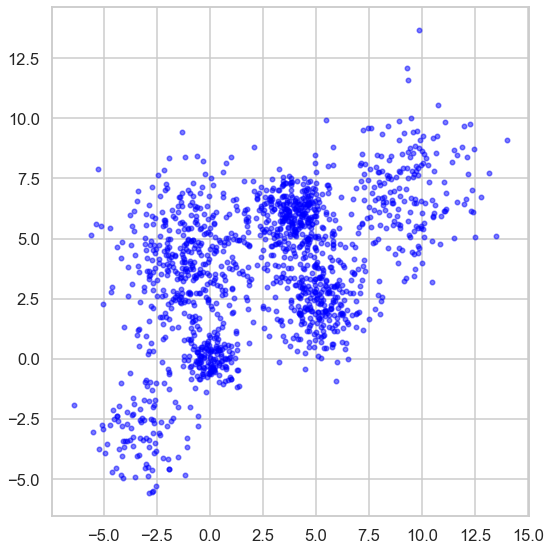

In [4]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

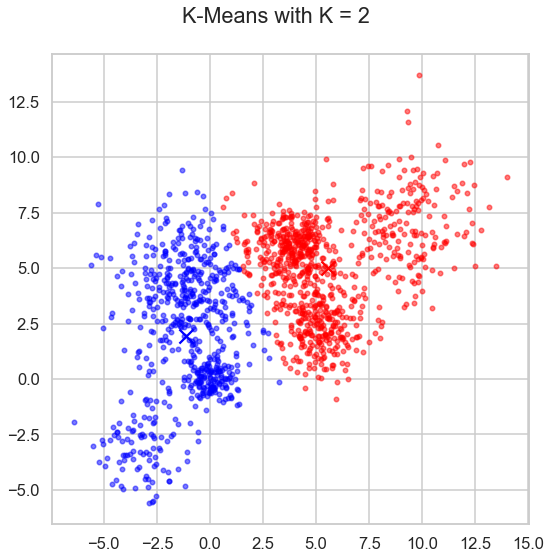

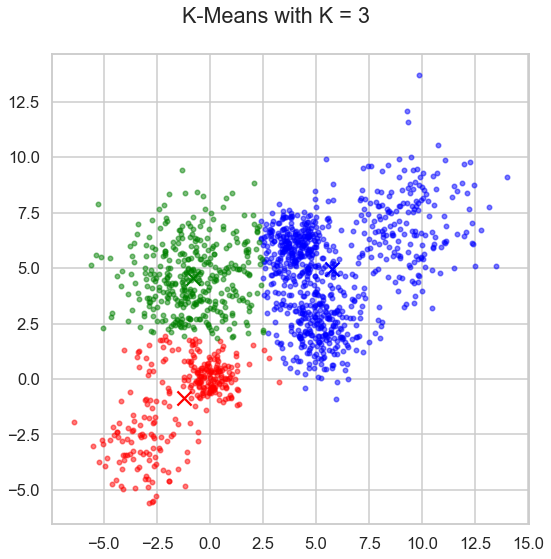

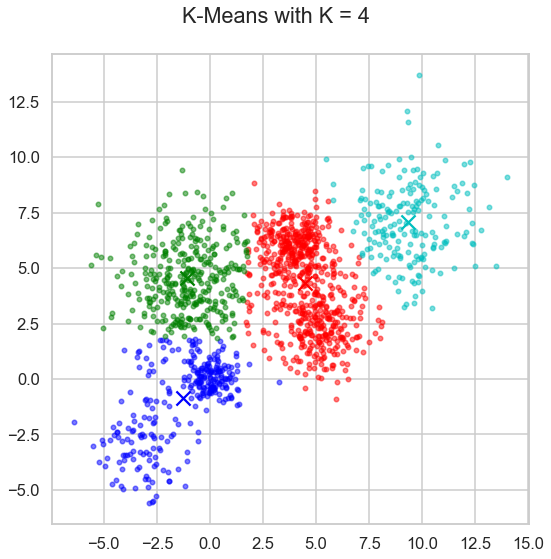

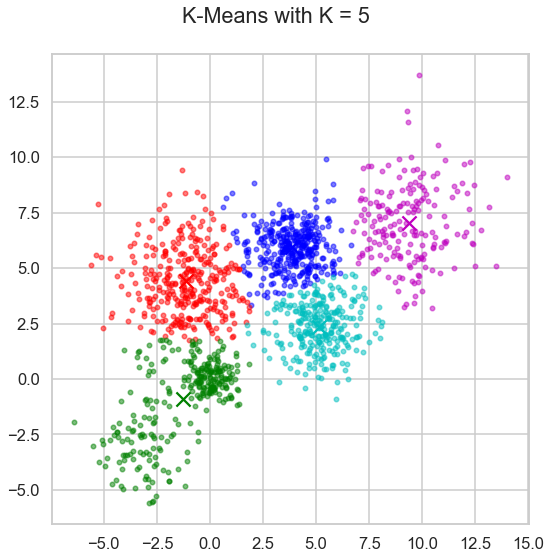

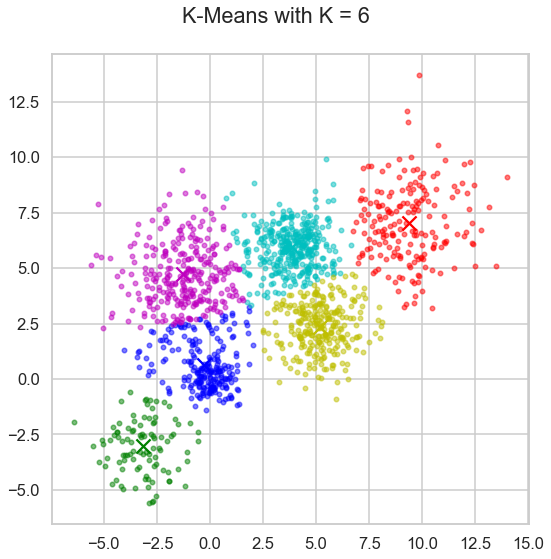

...

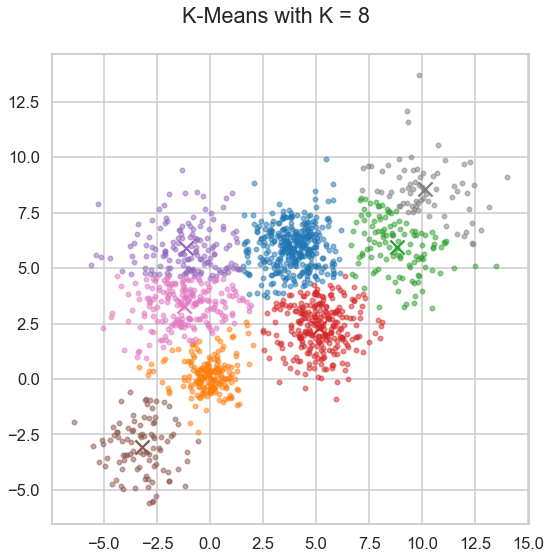

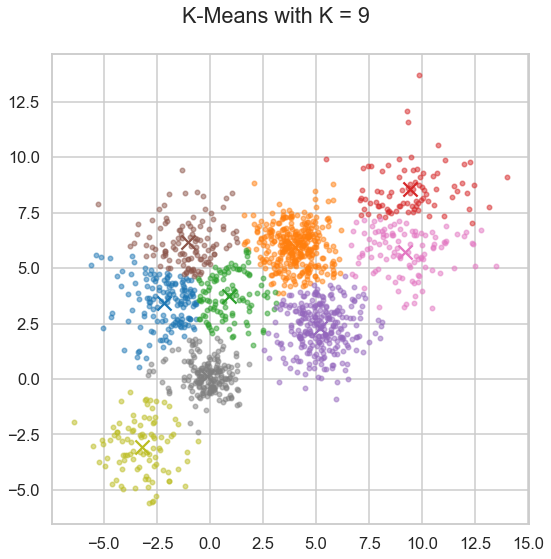

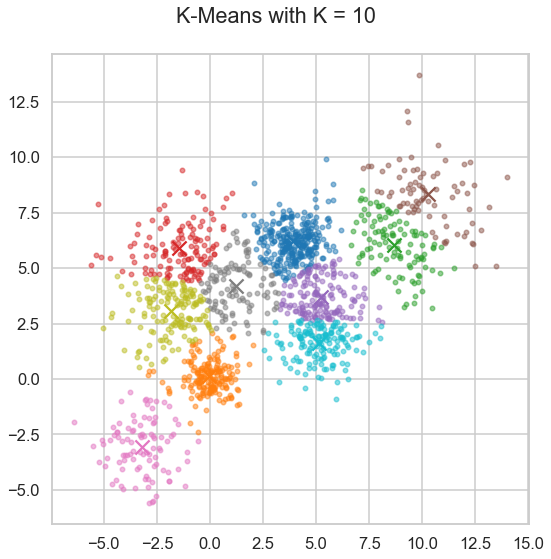

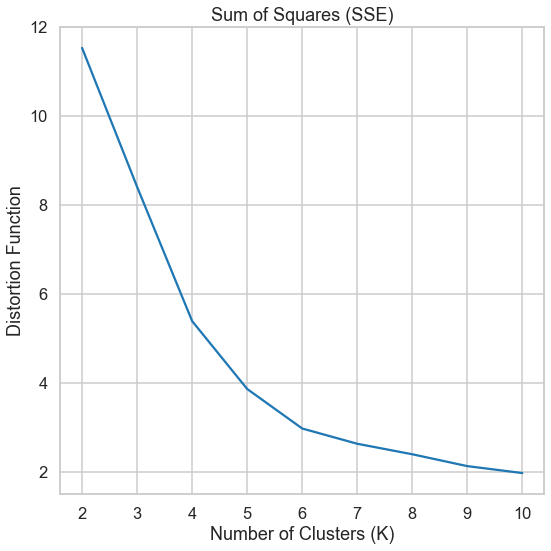

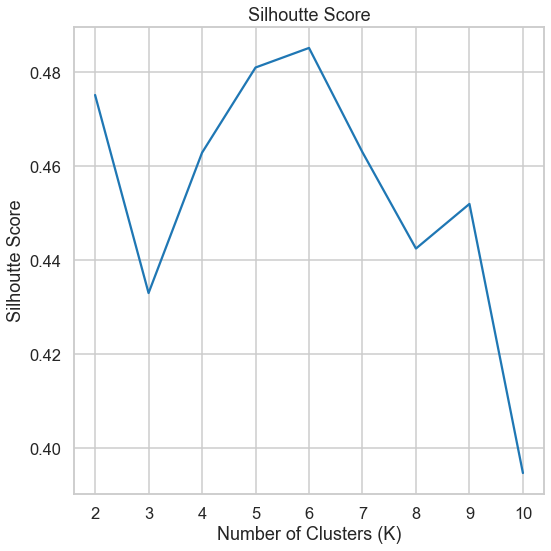

Silhouette Score = 0.4851736532125523 @ K = 6


In [5]:
X = Multi_blob_Data
metrics = []
silhouette = []
best_silhouettes = dict()
start_K = 2
stop_K = 11
for num_clusters in range(start_K, stop_K):
    fig = plt.figure()
    Final_Cluster_Distance = KMeans(n_clusters=num_clusters).fit(X)
    metrics.append(Final_Cluster_Distance.inertia_/len(X))
    silhouette.append(silhouette_score(X, Final_Cluster_Distance.labels_))
    display_cluster(X, km=Final_Cluster_Distance, num_clusters=num_clusters, mode="kmeans")
    fig.suptitle(f"K-Means with K = {num_clusters}")
    fig.tight_layout()

max_pos = np.argmax(silhouette)
params_dict = dict()
params_dict["K"] = max_pos + start_K
params_dict["score"] = silhouette[max_pos]
best_silhouettes.update({"kmeans":params_dict})

plt.figure()
plt.plot(np.arange(start_K,stop_K), metrics)
plt.title("Sum of Squares (SSE)")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Distortion Function")
plt.tight_layout()
plt.show()

plt.figure()
plt.plot(np.arange(start_K,stop_K), silhouette)
plt.title("Silhoutte Score")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Silhoutte Score")
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {silhouette[max_pos]} @ K = {max_pos+start_K}")

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

In [6]:
def plot_dendrogram(model, **kwargs):
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    dendrogram(linkage_matrix, **kwargs)

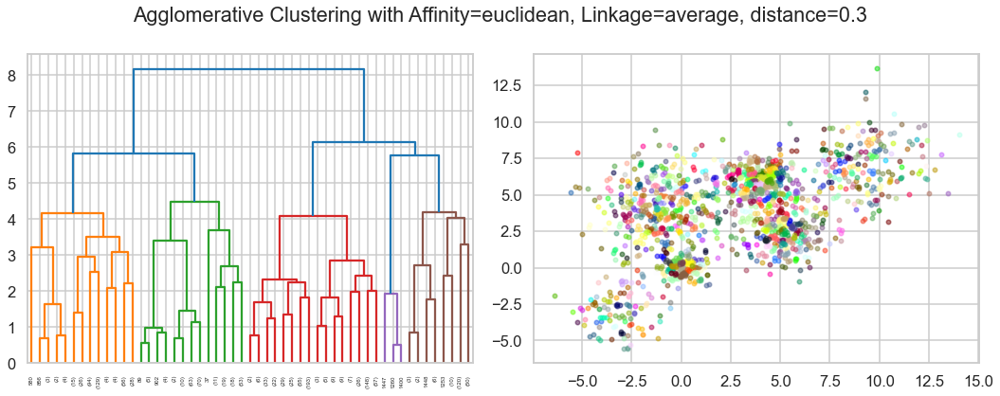

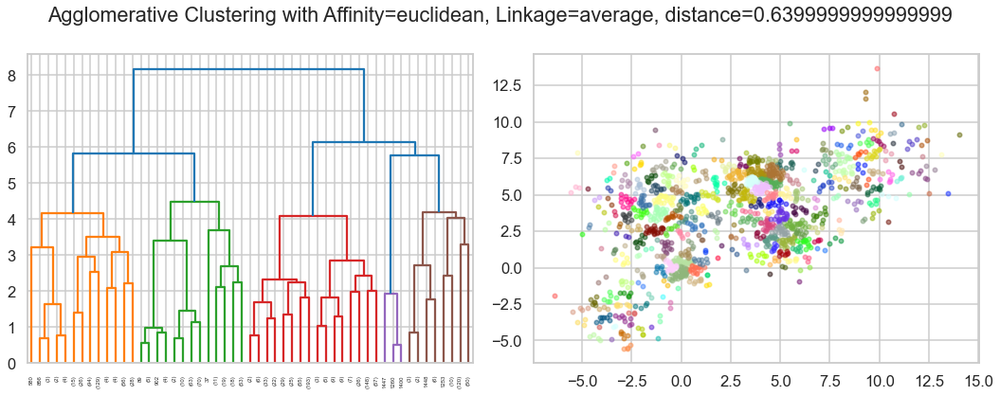

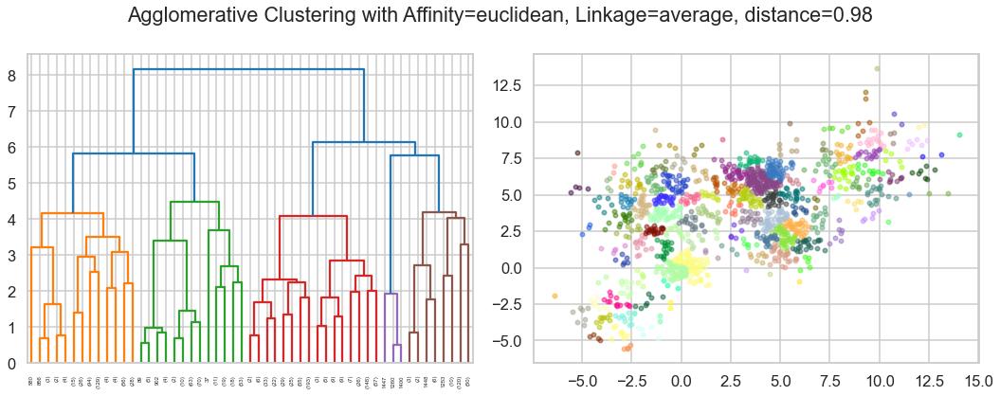

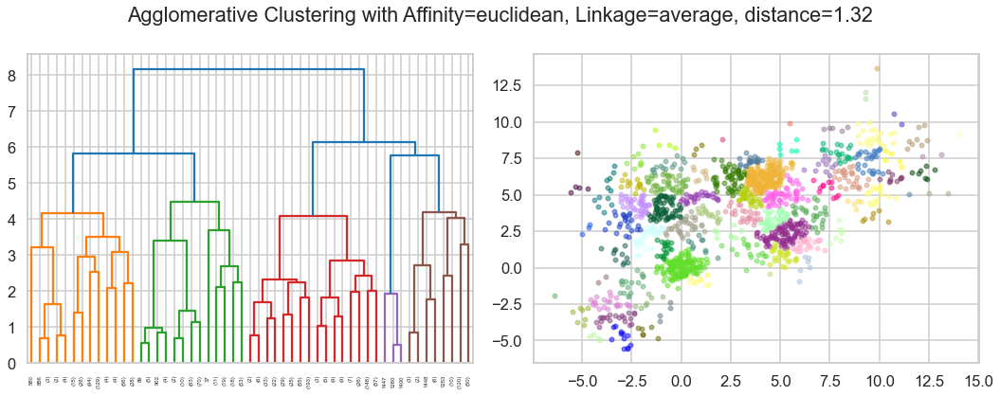

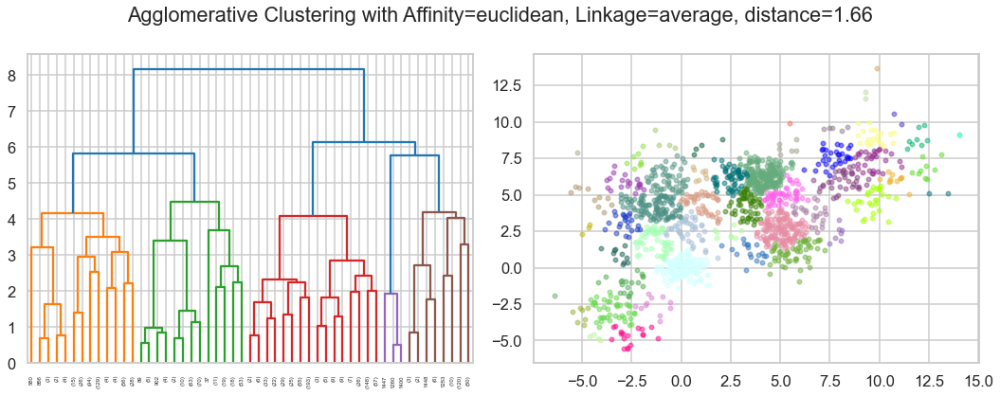

...

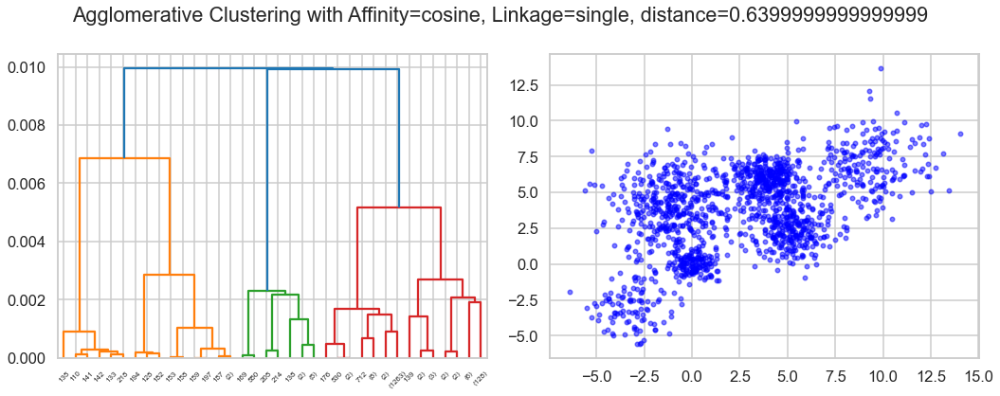

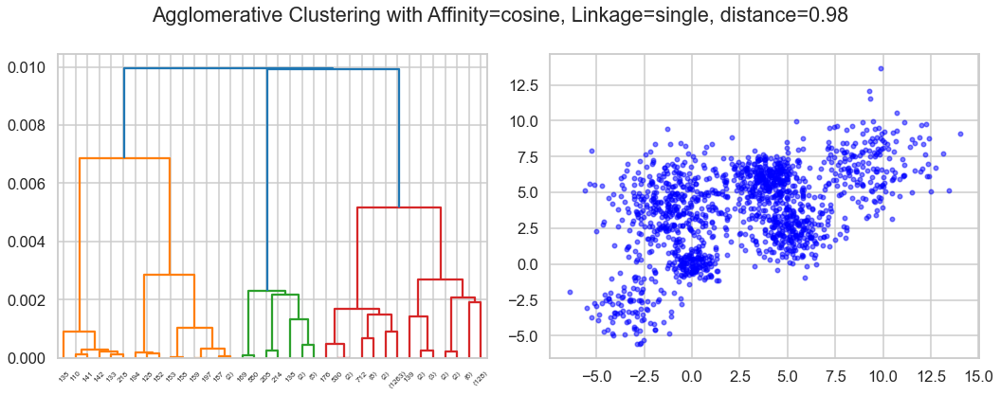

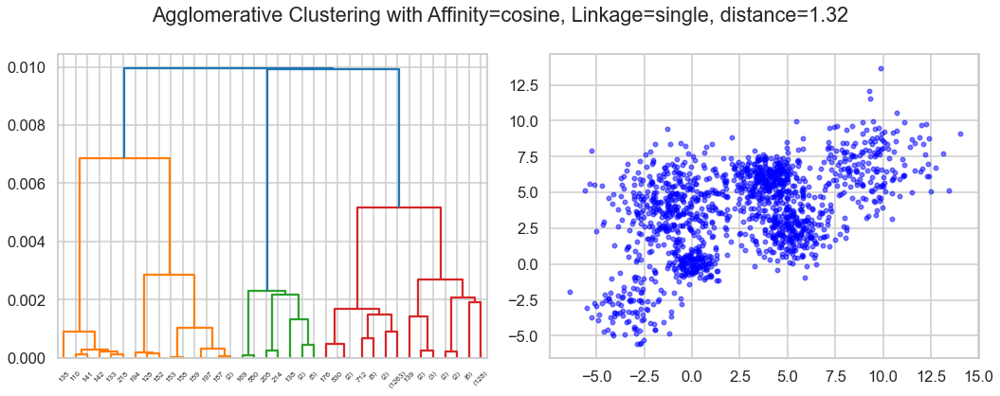

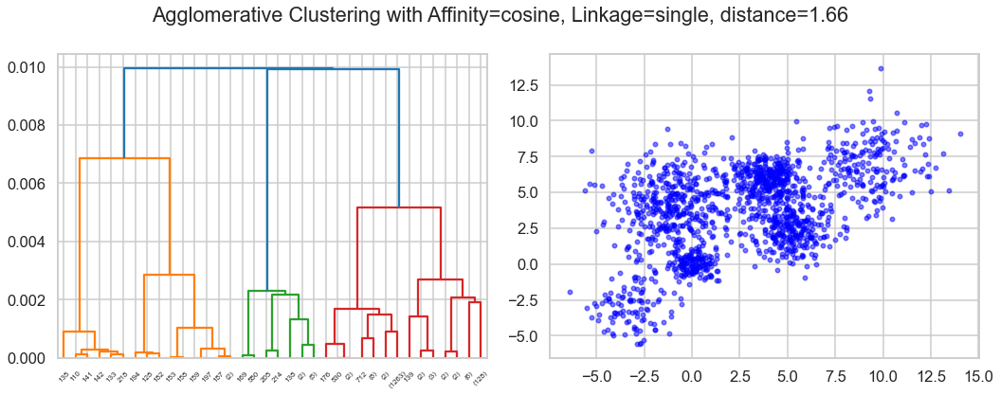

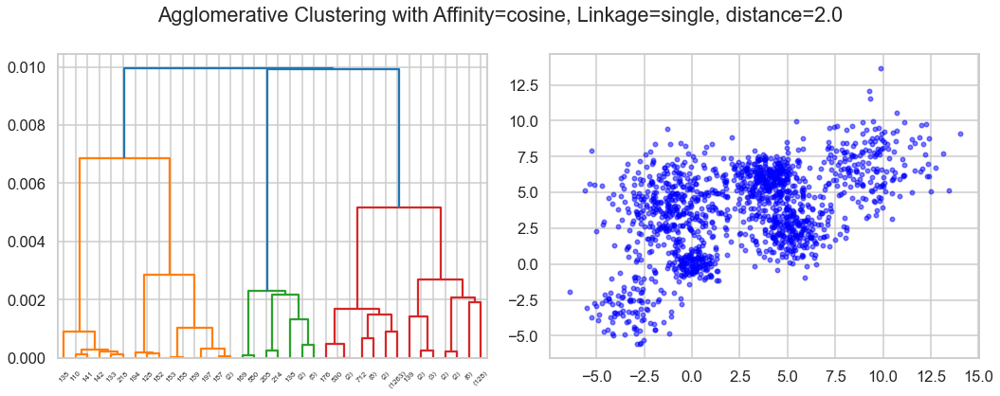

Silhouette Score = 0.37017212432259794 @ Affinity=manhattan, Linkage=average, distance_threshold=0.6399999999999999


In [7]:
params_dict = dict()
distances = np.linspace(0.3,2,6)
for affinity in ["euclidean", "manhattan", "cosine"]:
    for linkage in ["average","single"]:
        for distance_threshold in distances:
            Final_Cluster_Distance = AgglomerativeClustering(n_clusters=None, metric=affinity, linkage=linkage, distance_threshold=distance_threshold).fit(X)
            if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X, Final_Cluster_Distance.labels_)
                params_dict[(affinity, linkage, distance_threshold)] = silhouette
            plt.figure(figsize=(15,6))
            plt.suptitle(f"Agglomerative Clustering with Affinity={affinity}, Linkage={linkage}, distance={distance_threshold}")
            plt.subplot(1,2,1)
            plot_dendrogram(Final_Cluster_Distance, truncate_mode="level",p=5)
            plt.subplot(1,2,2)
            display_cluster(X, km=Final_Cluster_Distance,mode="agglo")
            plt.tight_layout()
            plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"metric":params[0], "linkage":params[1], "distance_threshold":params[2], "score":score}
best_silhouettes.update({"agglomerative":params_dict})

print(f"Silhouette Score = {score} @ Affinity={params[0]}, Linkage={params[1]}, distance_threshold={params[2]}")

In [ ]:
"""
class Point:
    def __init__(self, x, y, id):
        self._x = x
        self._y = y
        self._id = id
        self._next = None
    
    def merge(self, other, dist, id):
        p = Point((self._x+other._x)/2, max(self._y, other._y)+dist, id)
        self._next = p
        other._next = p
        return p

def calc_distances(data_points, selected_point, distance_type):
    if distance_type == "Euclidean":
        return np.sqrt(np.sum(np.square(data_points - selected_point), axis=1, keepdims=True))

def AgglomerativeClustering(data_points, affinity, linkage, distance_threshold):
    agglo = np.copy(data_points)
    
    while True:
        min_dist = np.inf
        min_p1_index = None
        min_p2_index = None
        for i in range(len(agglo)):
            distances = calc_distances(agglo, agglo[i], affinity)
            min_current_dist_pos = np.argmin(np.append(distances[:i], distances[i+1:]))
            if min_current_dist_pos >= i: min_current_dist_pos += 1
            if distances[min_current_dist_pos] < min_dist and distances[min_current_dist_pos] < distance_threshold:
                min_dist = distances[min_current_dist_pos]
                min_p1_index = i
                min_p2_index = min_current_dist_pos
        if np.isinf(min_dist) or len(agglo) == 1:
            break
        new_point = np.mean([agglo[min_p1_index], agglo[min_p2_index]], axis=0)
        agglo = np.append( np.delete(agglo, [min_p1_index, min_p2_index], axis=0), [new_point], axis=0)
    return agglo

agglo = AgglomerativeClustering(X, "Euclidean", 1, 0.2)
print(len(agglo))
"""

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

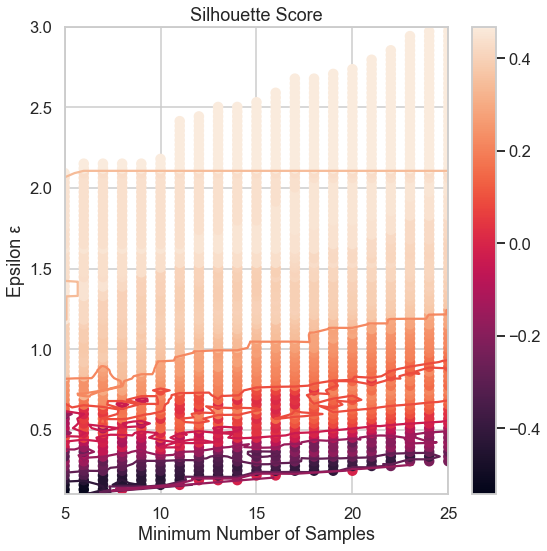

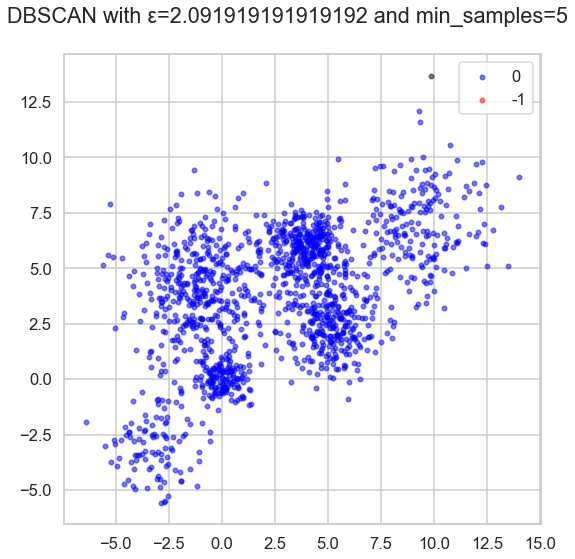

Silhouette Score = 0.4685207355522043 @ ε=2.091919191919192, min_samples=5.0


In [9]:
params_dict = dict()
epsilons = np.linspace(0.1,3,100)
min_samples_list = np.arange(5,25+1)
for eps in epsilons:
    for min_samples in min_samples_list:
        Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X)
        if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X, Final_Cluster_Distance.labels_)
                params_dict[(eps, min_samples)] = silhouette
        
dict_keys = np.array(list(params_dict.keys()))
dict_vals = np.array(list(params_dict.values()))
eps_vals = dict_keys[:,0]
num_samples_vals = dict_keys[:,1].astype(int)
Z = dict_vals[:]
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"eps":params[0], "min_samples":int(params[1]), "score":score}
best_silhouettes.update({"dbscan":params_dict})

plt.figure()
plt.tricontour(num_samples_vals,eps_vals,Z)
plt.scatter(num_samples_vals, eps_vals, c=Z)
plt.xlabel("Minimum Number of Samples")
plt.ylabel("Epsilon \u03B5")
plt.title("Silhouette Score")
plt.colorbar()
plt.tight_layout()
plt.show()

eps = params[0]
min_samples = int(params[1])
Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X)
plt.figure()
plt.suptitle(f"DBSCAN with \u03B5={eps} and min_samples={min_samples}")
display_cluster(X, km=Final_Cluster_Distance,mode="dbscan")
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {score} @ \u03B5={params[0]}, min_samples={params[1]}")

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

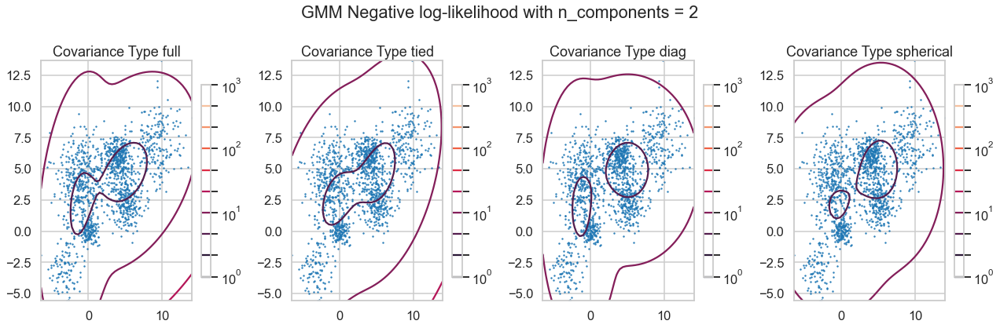

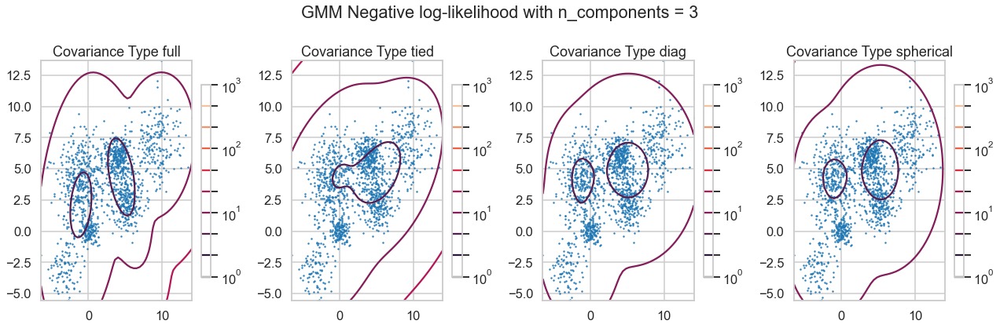

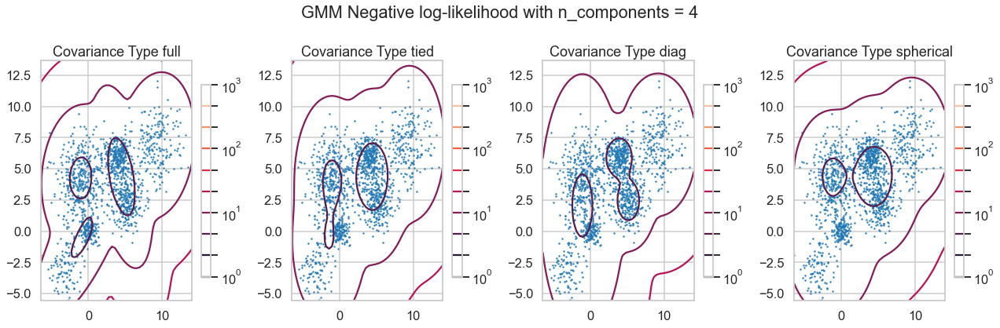

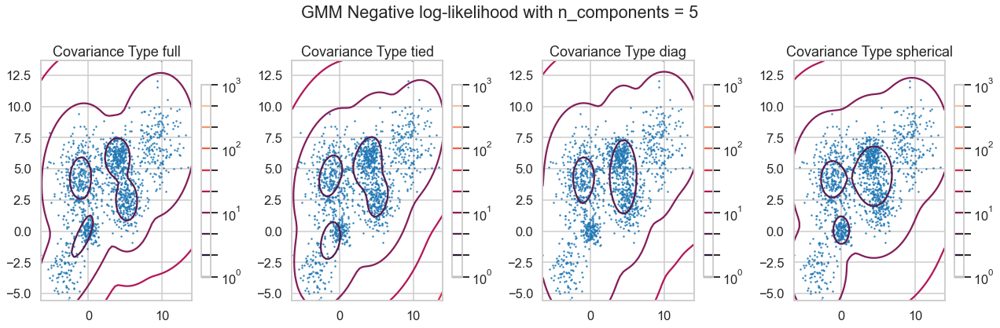

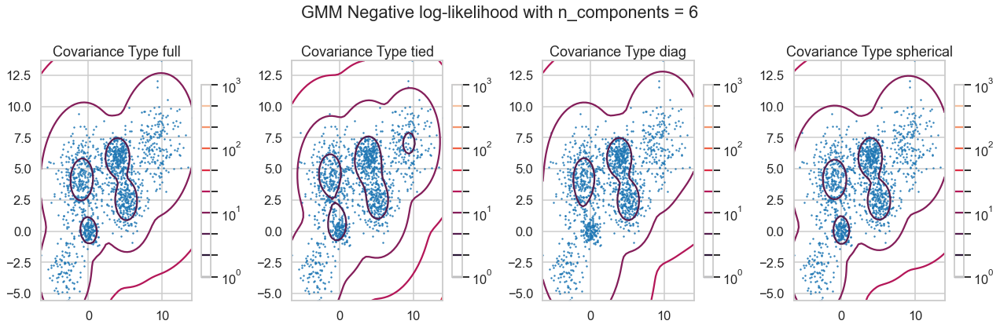

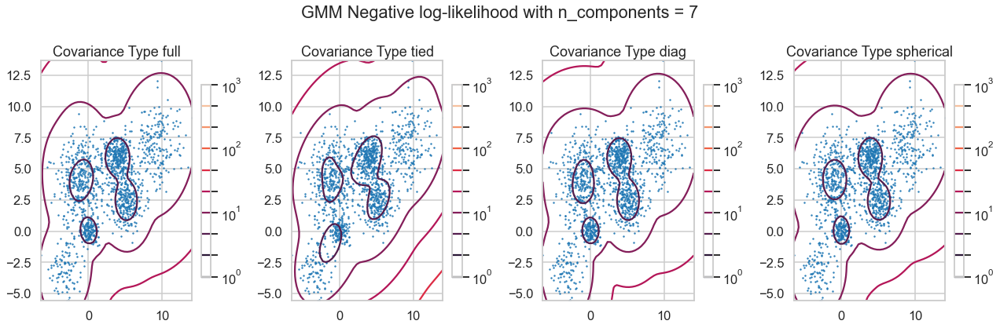

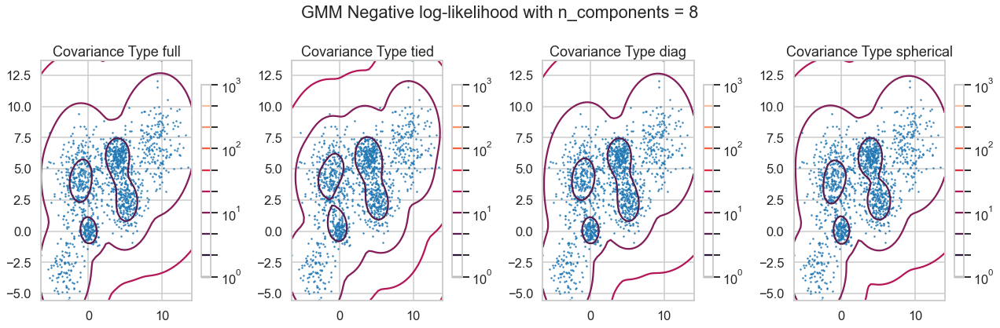

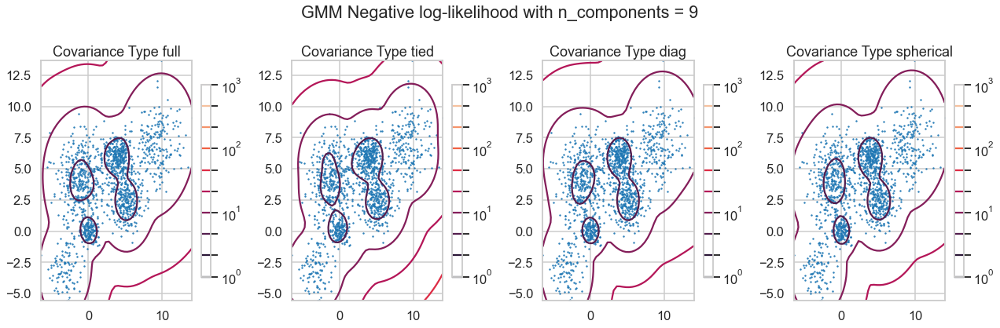

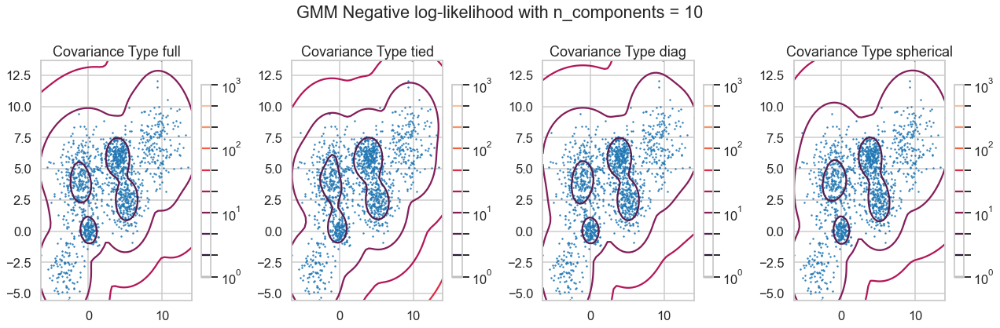

Silhouette Score = 0.4857649897596247 @ n_components=6, covariance_type=tied


In [10]:
from matplotlib.colors import LogNorm
X = Multi_blob_Data
params_dict = dict()
num_clusters = np.arange(2,11)
covariances = ["full", "tied", "diag", "spherical"]
for k in num_clusters:
    plt.figure(figsize=(18,6))
    plt.suptitle(f"GMM Negative log-likelihood with n_components = {k}")
    for covariance_type_index in range(len(covariances)):
        covariance_type = covariances[covariance_type_index]
        plt.subplot(1,4,covariance_type_index+1)
        Final_Cluster_Distance = GaussianMixture(n_components=k, covariance_type=covariance_type).fit(X)
        labels = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
        silhouette = silhouette_score(X, labels)
        params_dict[(k, covariance_type)] = silhouette
        
        x = np.linspace(np.min(X[:,0]), np.max(X[:,0]))
        y = np.linspace(np.min(X[:,1]), np.max(X[:,1]))
        XX, YY = np.meshgrid(x, y)
        XXX = np.array([XX.ravel(), YY.ravel()]).T
        Z = -Final_Cluster_Distance.score_samples(XXX)
        Z = Z.reshape(XX.shape)
        
        CS = plt.contour(XX, YY, Z, norm=LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
        CB = plt.colorbar(CS, shrink=0.8, extend="both")
        plt.scatter(X[:,0], X[:,1], 0.8)
        plt.title(f"Covariance Type {covariance_type}")
        plt.tight_layout()
    plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"n_components":params[0], "covariance_type":params[1], "score":score}
best_silhouettes.update({"gmm":params_dict})

print(f"Silhouette Score = {score} @ n_components={params[0]}, covariance_type={params[1]}")

In [11]:
best_silhouettes

{'kmeans': {'K': 6, 'score': 0.4851736532125523},
 'agglomerative': {'metric': 'manhattan',
  'linkage': 'average',
  'distance_threshold': 0.6399999999999999,
  'score': 0.37017212432259794},
 'dbscan': {'eps': 2.091919191919192,
  'min_samples': 5,
  'score': 0.4685207355522043},
 'gmm': {'n_components': 6,
  'covariance_type': 'tied',
  'score': 0.4857649897596247}}

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [12]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

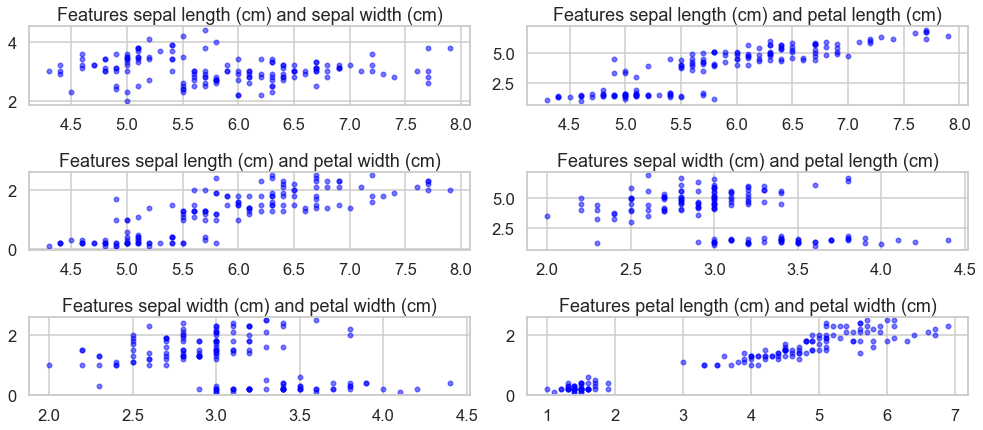

In [13]:
plt.figure(figsize=(14,12))
X = iris_data["data"]
display_cluster(X, labels=iris_data.feature_names)
plt.tight_layout()

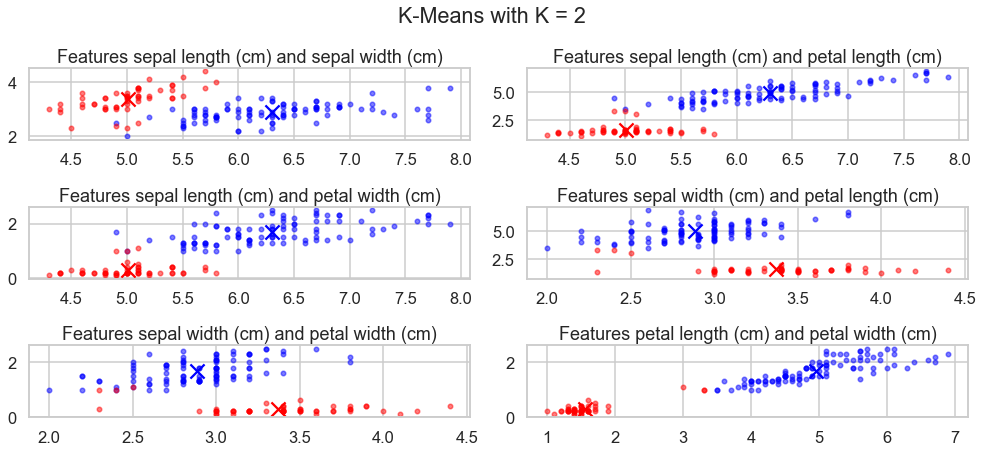

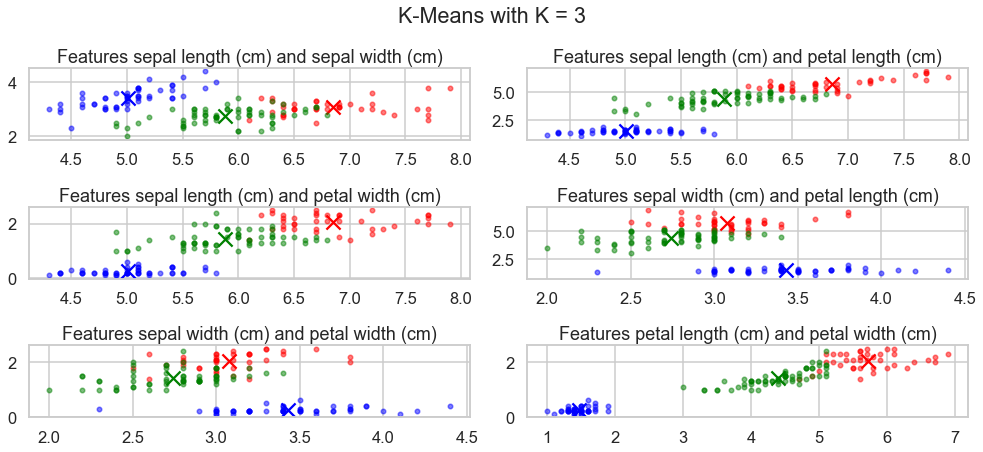

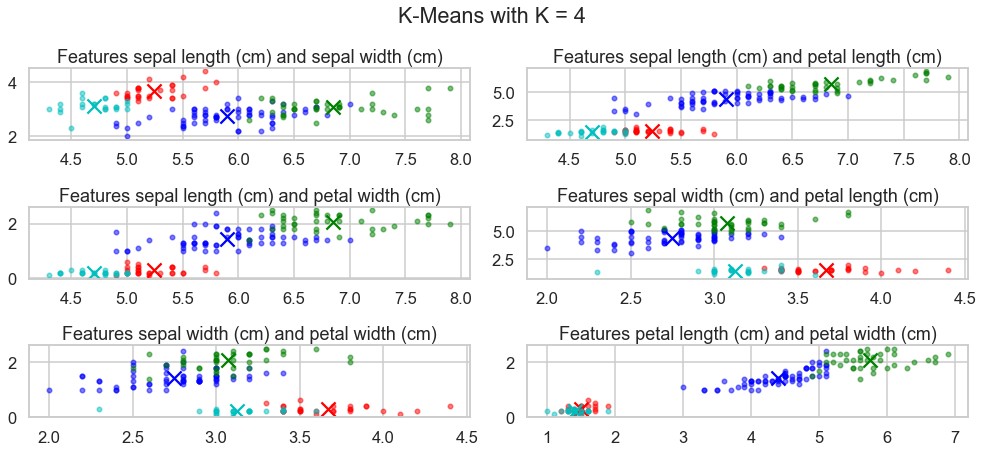

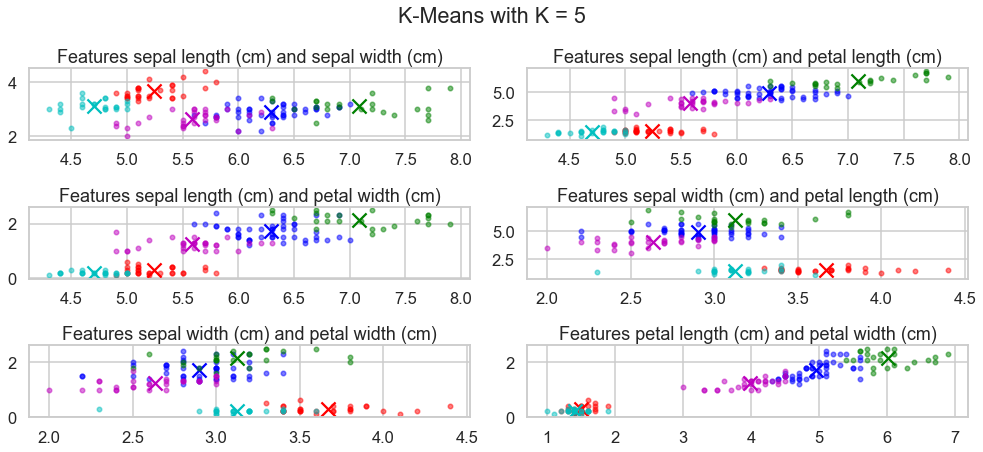

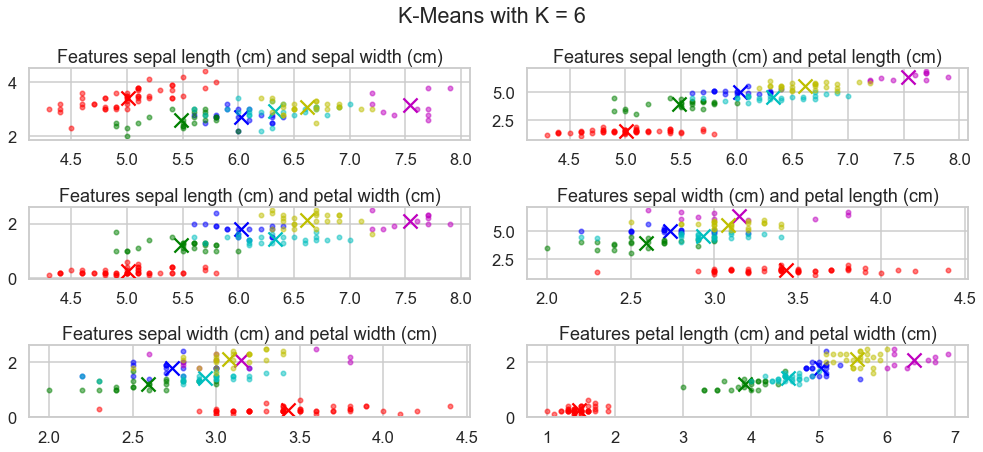

...

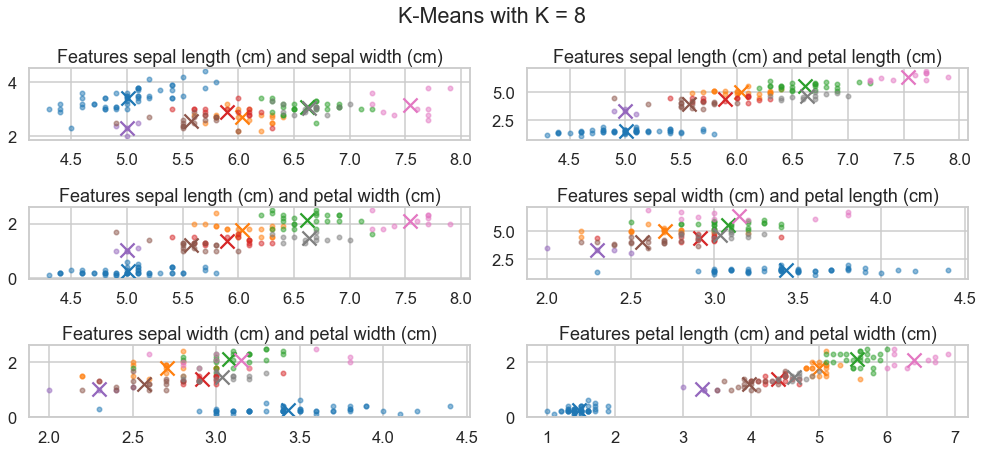

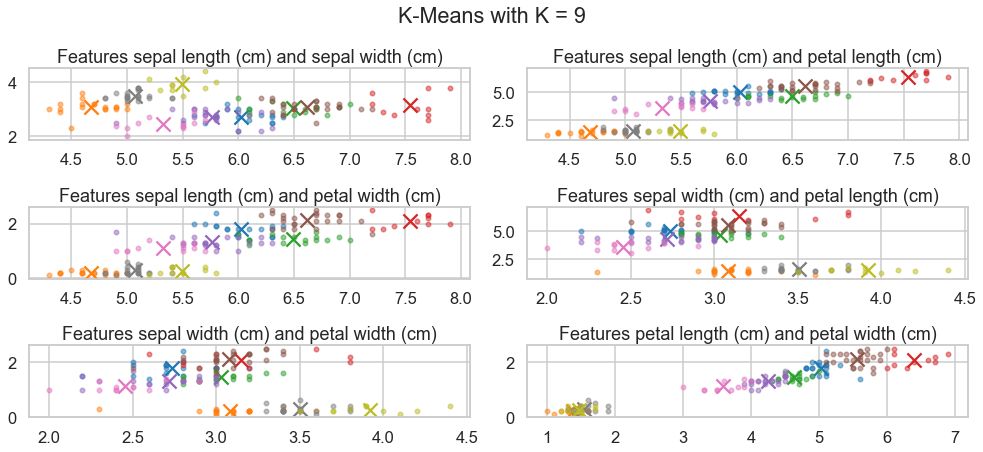

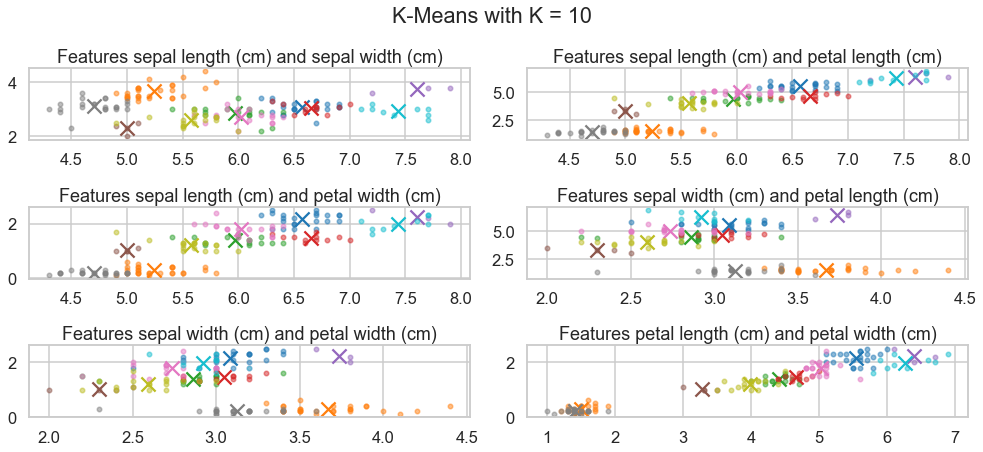

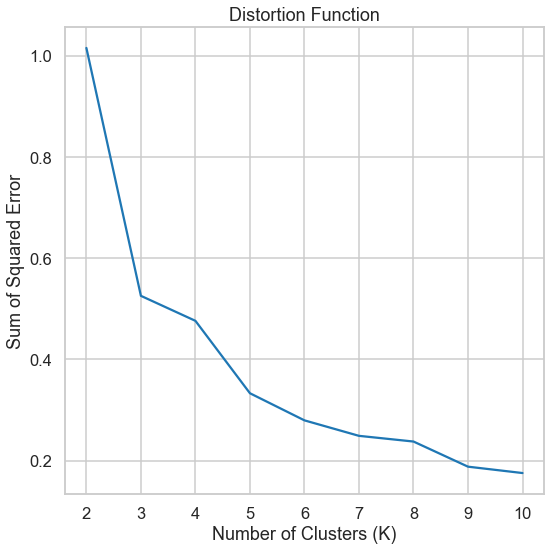

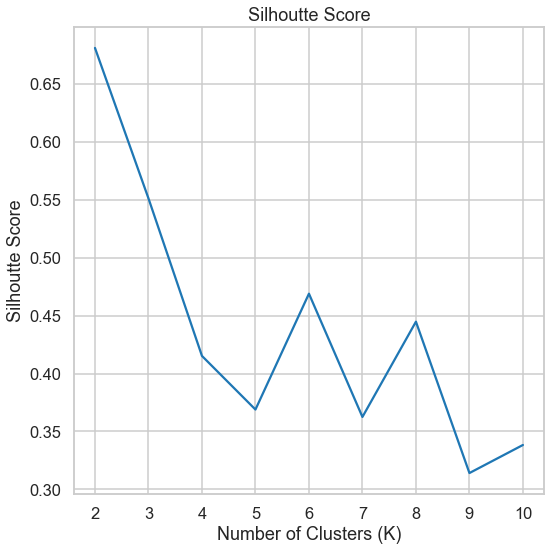

Silhouette Score = 0.6810461692117462 @ K = 2


In [14]:
best_silhouettes = dict()
start_K = 2
stop_K = 11
metrics = []
silhouette = []
for num_clusters in range(start_K,stop_K):
    fig = plt.figure(figsize=(14,12))
    Final_Cluster_Distance = KMeans(n_clusters=num_clusters).fit(X)
    metrics.append(Final_Cluster_Distance.inertia_/len(X))
    silhouette.append(silhouette_score(X, Final_Cluster_Distance.labels_))
    display_cluster(X, km=Final_Cluster_Distance, num_clusters=num_clusters, mode="kmeans", labels=iris_data.feature_names)
    fig.suptitle(f"K-Means with K = {num_clusters}")
    fig.tight_layout()

    
max_pos = np.argmax(silhouette)
params_dict = dict()
params_dict["K"] = max_pos + start_K
params_dict["score"] = silhouette[max_pos]
best_silhouettes.update({"kmeans":params_dict})

plt.figure()
plt.plot(np.arange(start_K,stop_K), metrics)
plt.title("Distortion Function")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Sum of Squared Error")
plt.tight_layout()
plt.show()

plt.figure()
plt.plot(np.arange(start_K,stop_K), silhouette)
plt.title("Silhoutte Score")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Silhoutte Score")
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {silhouette[max_pos]} @ K = {max_pos+start_K}")

In [15]:
Final_Cluster_Distance = KMeans(n_clusters=3, random_state=5).fit(X)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of K-Means Clustering = {acc:.2f}%")

Accuracy of K-Means Clustering = 89.33%


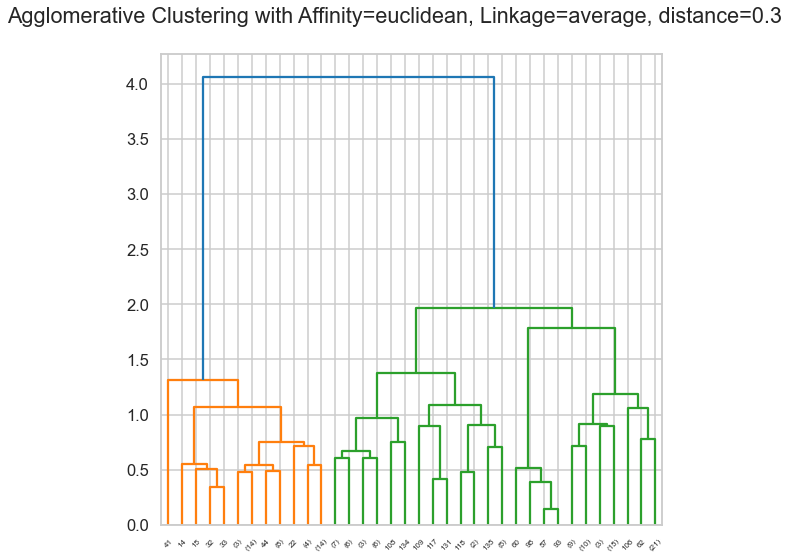

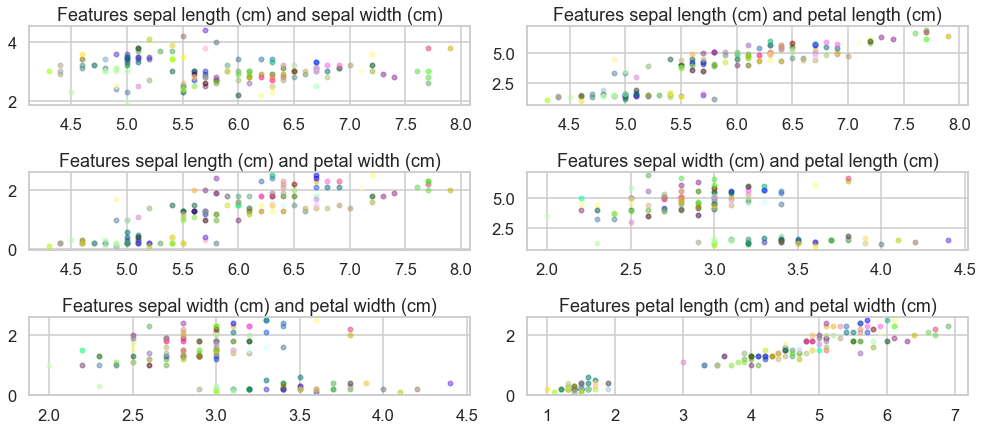

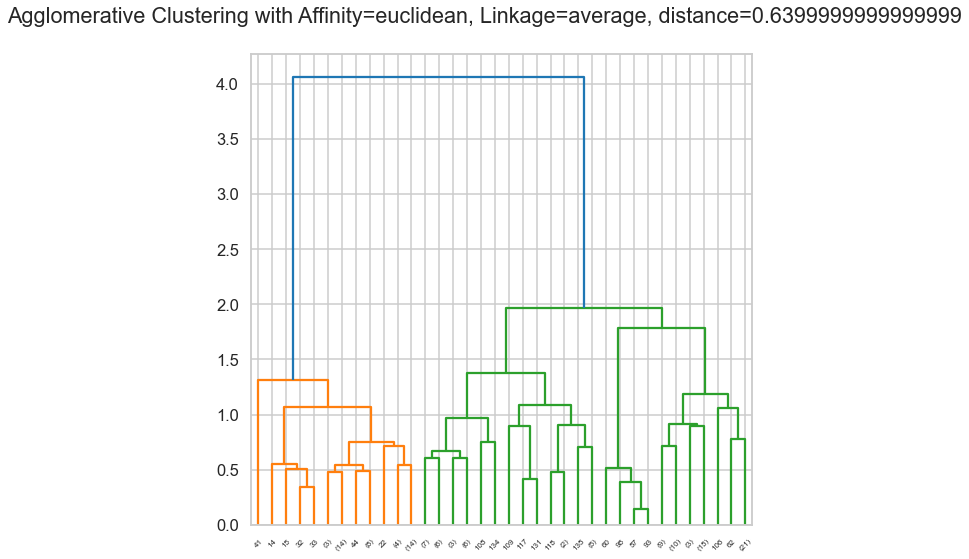

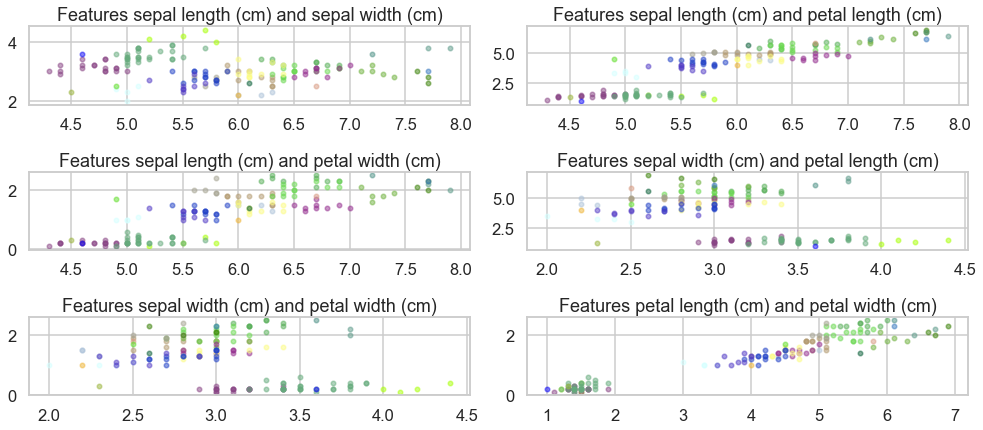

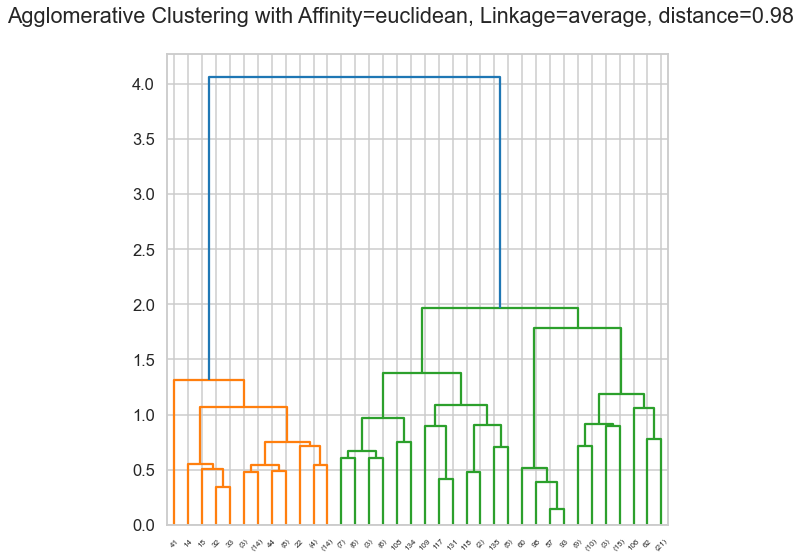

...

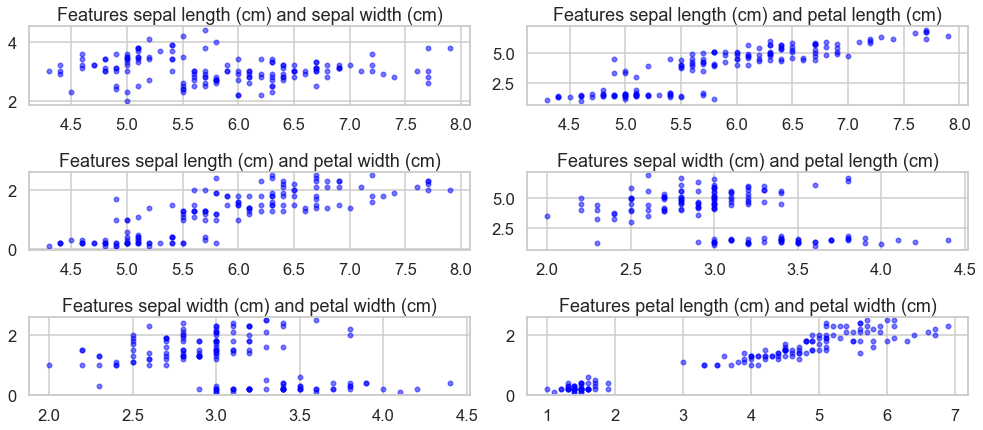

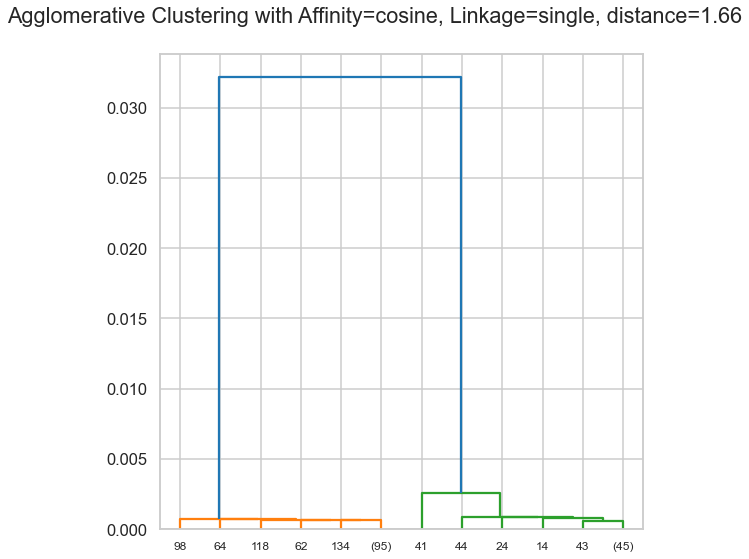

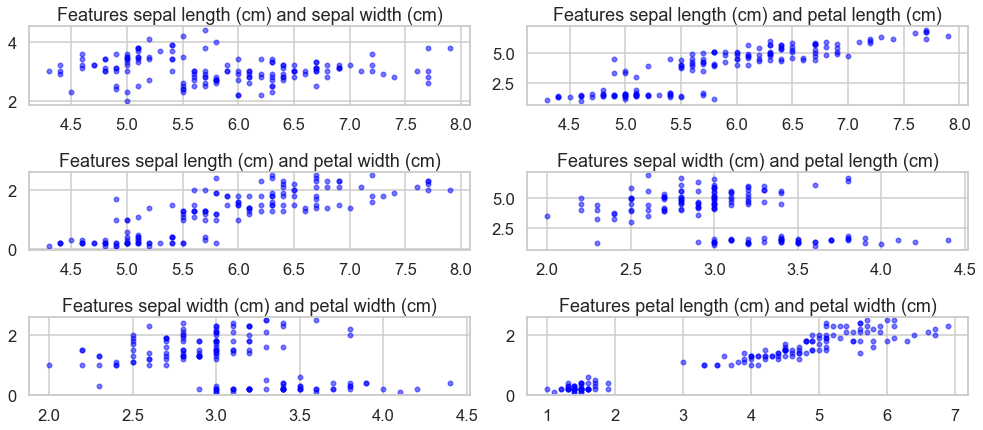

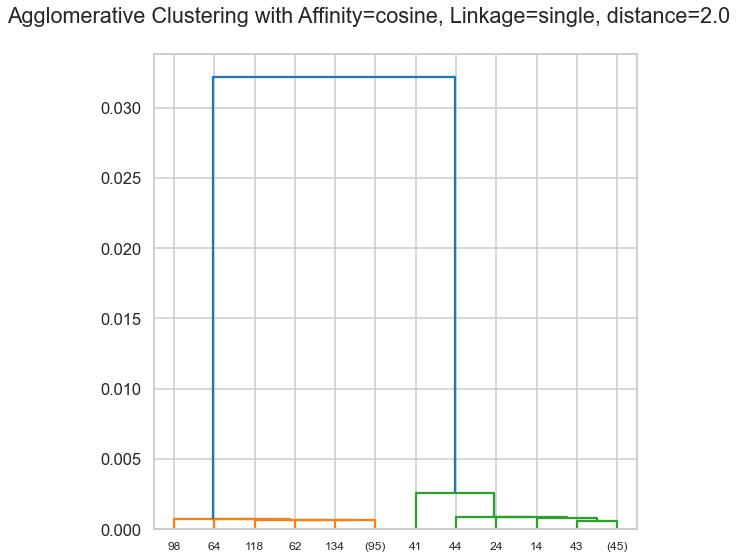

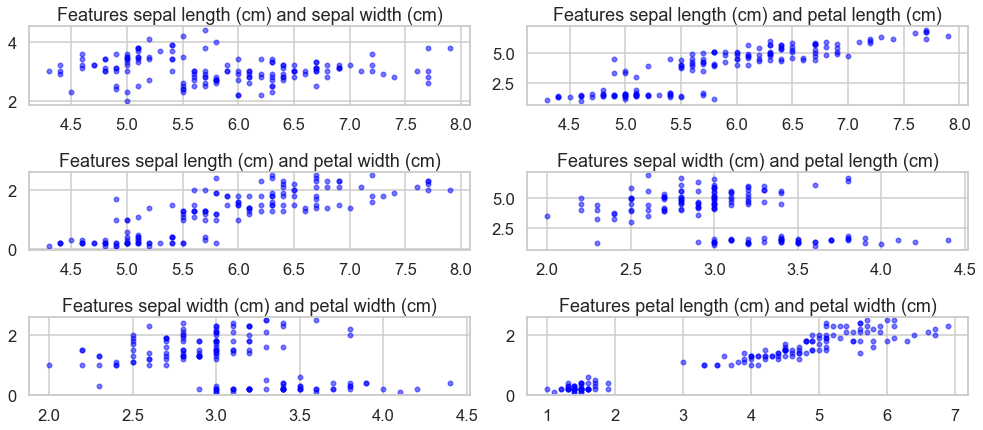

Silhouette Score = 0.6867350732769776 @ Affinity=euclidean, Linkage=average, distance_threshold=2.0


In [16]:
params_dict = dict()
distances = np.linspace(0.3,2,6)
for affinity in ["euclidean", "manhattan", "cosine"]:
    for linkage in ["average","single"]:
        for distance_threshold in distances:
            Final_Cluster_Distance = AgglomerativeClustering(n_clusters=None, metric=affinity, linkage=linkage, distance_threshold=distance_threshold).fit(X)
            if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X, Final_Cluster_Distance.labels_)
                params_dict[(affinity, linkage, distance_threshold)] = silhouette
            plt.suptitle(f"Agglomerative Clustering with Affinity={affinity}, Linkage={linkage}, distance={distance_threshold}")
            plot_dendrogram(Final_Cluster_Distance, truncate_mode="level",p=5)
            plt.tight_layout()
            plt.figure(figsize=(14,12))
            display_cluster(X, km=Final_Cluster_Distance,mode="agglo", labels=iris_data.feature_names)
            plt.tight_layout()
            plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"metric":params[0], "linkage":params[1], "distance_threshold":params[2], "score":score}
best_silhouettes.update({"agglomerative":params_dict})

print(f"Silhouette Score = {score} @ Affinity={params[0]}, Linkage={params[1]}, distance_threshold={params[2]}")

In [17]:
Final_Cluster_Distance = AgglomerativeClustering(n_clusters=3, metric="euclidean", linkage="average").fit(X)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target)
Final_Cluster_Distance.labels_ = (1 - Final_Cluster_Distance.labels_)
Final_Cluster_Distance.labels_[Final_Cluster_Distance.labels_==-1] = 2
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Agglomerative Clustering: {acc:.2f}%")

Accuracy of Agglomerative Clustering: 90.67%


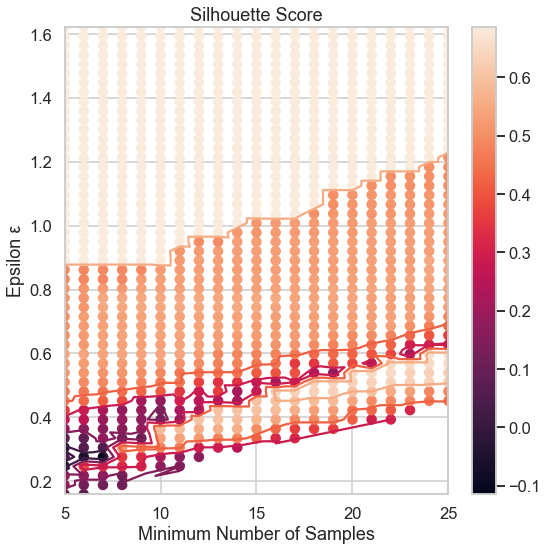

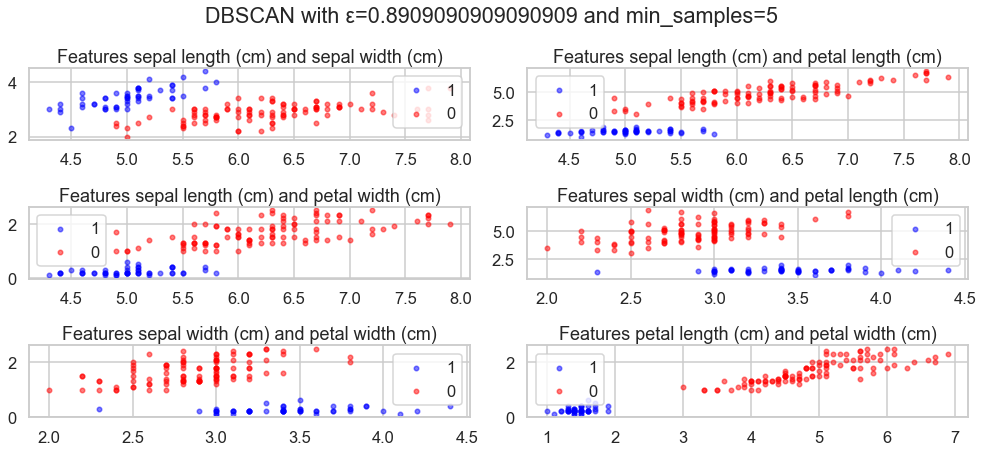

Silhouette Score = 0.6867350732769776 @ ε=0.8909090909090909, min_samples=5.0


In [18]:
params_dict = dict()
epsilons = np.linspace(0.1,3,100)
min_samples_list = np.arange(5,25+1)
for eps in epsilons:
    for min_samples in min_samples_list:
        Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X)
        if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X, Final_Cluster_Distance.labels_)
                params_dict[(eps, min_samples)] = silhouette
        
dict_keys = np.array(list(params_dict.keys()))
dict_vals = np.array(list(params_dict.values()))
eps_vals = dict_keys[:,0]
num_samples_vals = dict_keys[:,1].astype(int)
Z = dict_vals[:]
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"eps":params[0], "min_samples":int(params[1]), "score":score}
best_silhouettes.update({"dbscan":params_dict})

plt.figure()
plt.tricontour(num_samples_vals,eps_vals,Z)
plt.scatter(num_samples_vals, eps_vals, c=Z)
plt.xlabel("Minimum Number of Samples")
plt.ylabel("Epsilon \u03B5")
plt.title("Silhouette Score")
plt.colorbar()
plt.tight_layout()
plt.show()

eps = params[0]
min_samples = int(params[1])
Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X)
plt.figure(figsize=(14,12))
plt.suptitle(f"DBSCAN with \u03B5={eps} and min_samples={min_samples}")
display_cluster(X, km=Final_Cluster_Distance,mode="dbscan", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {score} @ \u03B5={params[0]}, min_samples={params[1]}")

In [19]:
from matplotlib.colors import LogNorm
X = iris_data["data"]
params_dict = dict()
num_clusters = np.arange(2,11)
covariances = ["full", "tied", "diag", "spherical"]
for k in num_clusters:
    #plt.figure(figsize=(18,6))
    #plt.suptitle(f"GMM Negative log-likelihood with n_components = {k}")
    for covariance_type_index in range(len(covariances)):
        covariance_type = covariances[covariance_type_index]
        #plt.subplot(1,4,covariance_type_index+1)
        Final_Cluster_Distance = GaussianMixture(n_components=k, covariance_type=covariance_type).fit(X)
        labels = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
        silhouette = silhouette_score(X, labels)
        params_dict[(k, covariance_type)] = silhouette
        """
        temp = []
        for i in range(X.shape[1]):
            x = np.linspace(np.min(X[:,i]), np.max(X[:,i]))
            temp.append(x)
        XX = np.meshgrid(*temp)
        XXX = np.array([x.ravel() for x in XX]).T
        Z = -Final_Cluster_Distance.score_samples(XXX)
        Z = Z.reshape(XX[0].shape)
        
        CS = plt.contour(XX[0][:,:,0,0], XX[1][:,:,0,0], Z[:,:,0,0], norm=LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
        CB = plt.colorbar(CS, shrink=0.8, extend="both")
        plt.scatter(X[:,0], X[:,1], 0.8)
        plt.title(f"Covariance Type {covariance_type}")
        plt.tight_layout()
        """
    #plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"n_components":params[0], "covariance_type":params[1], "score":score}
best_silhouettes.update({"gmm":params_dict})

print(f"Silhouette Score = {score} @ n_components={params[0]}, covariance_type={params[1]}")

Silhouette Score = 0.6867350732769776 @ n_components=2, covariance_type=full


Accuracy of Gaussian Mixing Clustering (full): 96.67%


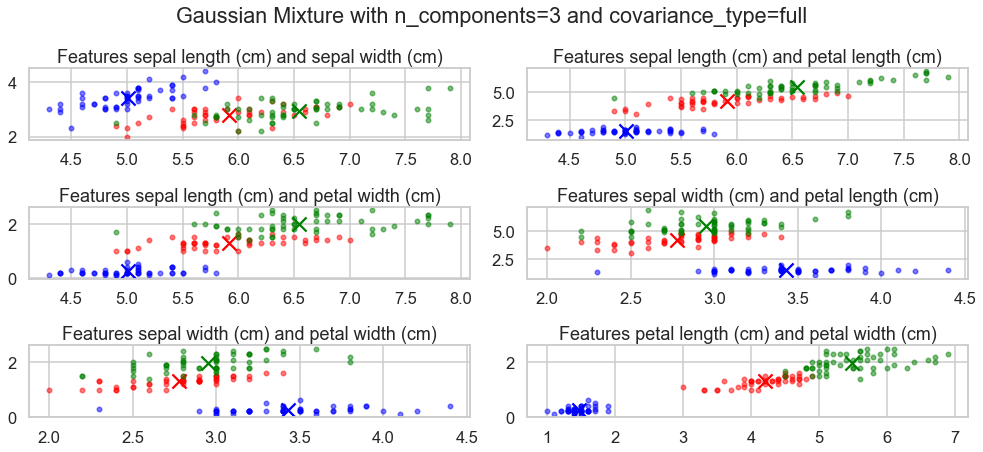

In [20]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="full", random_state=5).fit(X)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (full): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=full")
display_cluster(X,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (tied): 96.00%


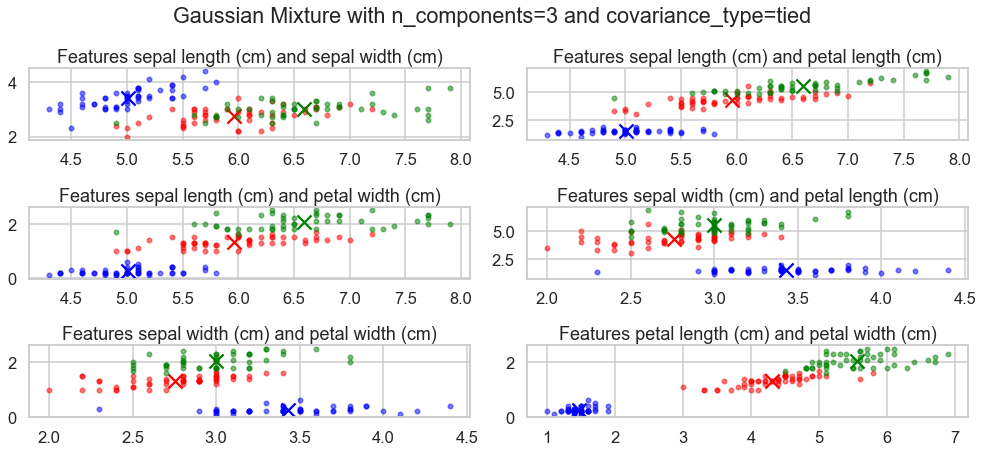

In [21]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="tied", random_state=5).fit(X)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (tied): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=tied")
display_cluster(X,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (diag): 90.67%


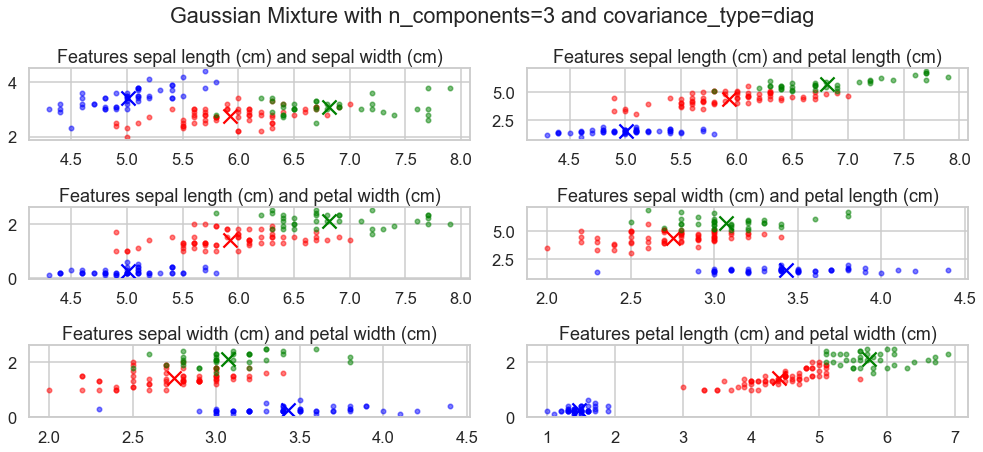

In [22]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="diag", random_state=5).fit(X)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (diag): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=diag")
display_cluster(X,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (spherical): 89.33%


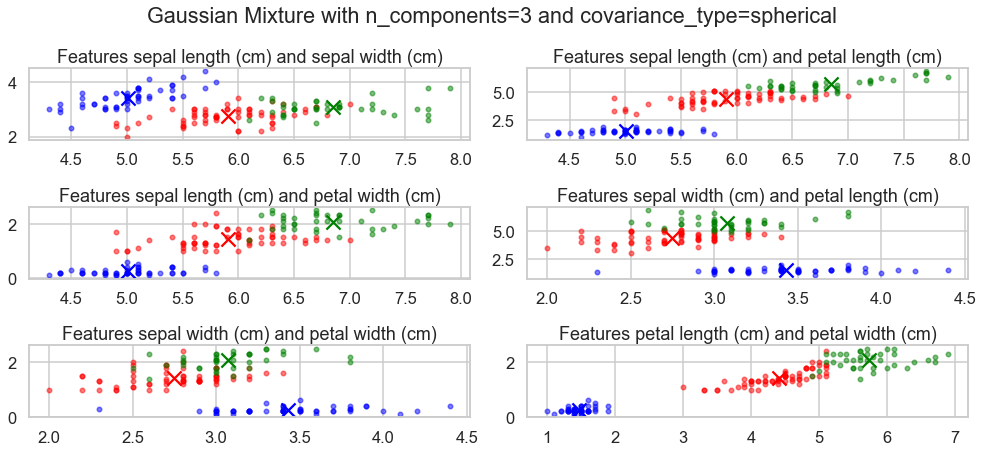

In [23]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="spherical", random_state=5).fit(X)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (spherical): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=spherical")
display_cluster(X,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

In [24]:
best_silhouettes

{'kmeans': {'K': 2, 'score': 0.6810461692117462},
 'agglomerative': {'metric': 'euclidean',
  'linkage': 'average',
  'distance_threshold': 2.0,
  'score': 0.6867350732769776},
 'dbscan': {'eps': 0.8909090909090909,
  'min_samples': 5,
  'score': 0.6867350732769776},
 'gmm': {'n_components': 2,
  'covariance_type': 'full',
  'score': 0.6867350732769776}}

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [25]:
scaler = StandardScaler()
X_norm = scaler.fit_transform(X)

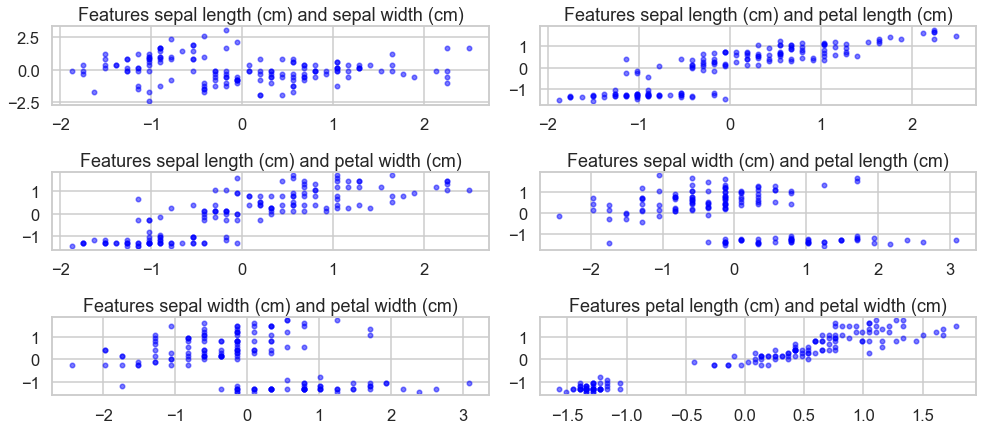

In [26]:
plt.figure(figsize=(14,12))
display_cluster(X_norm, labels=iris_data.feature_names)
plt.tight_layout()

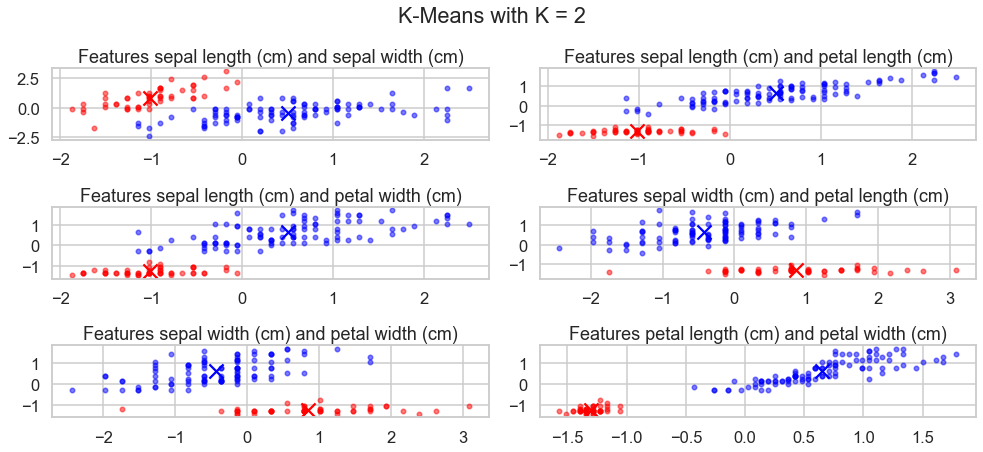

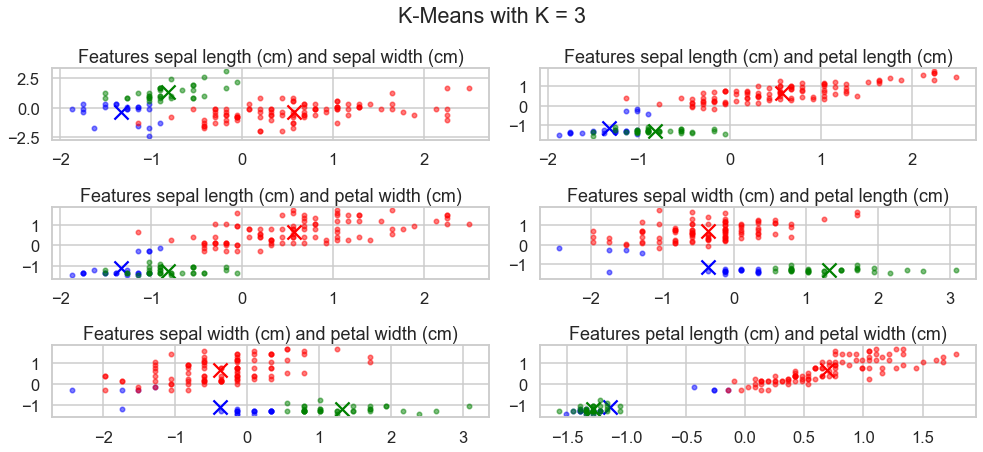

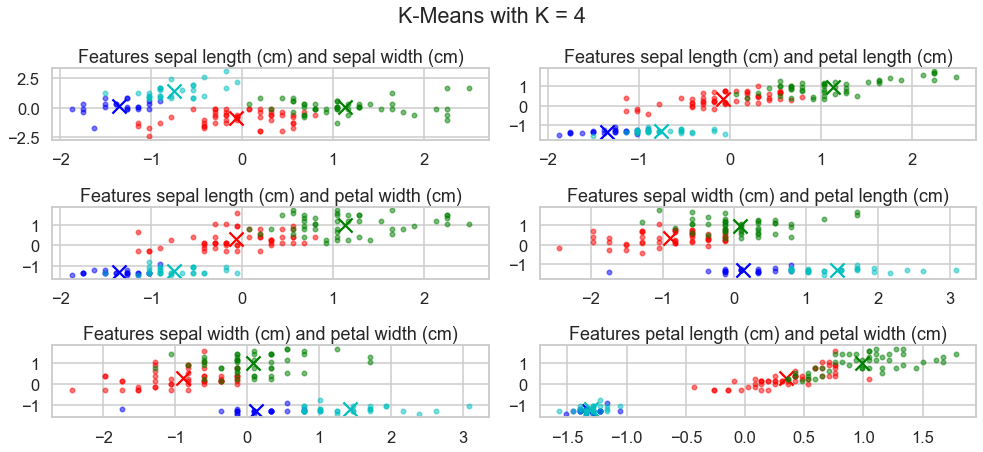

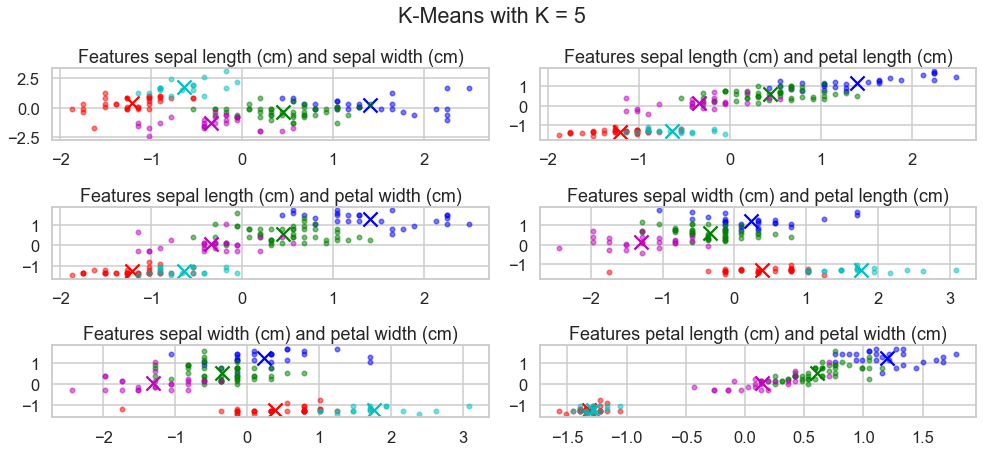

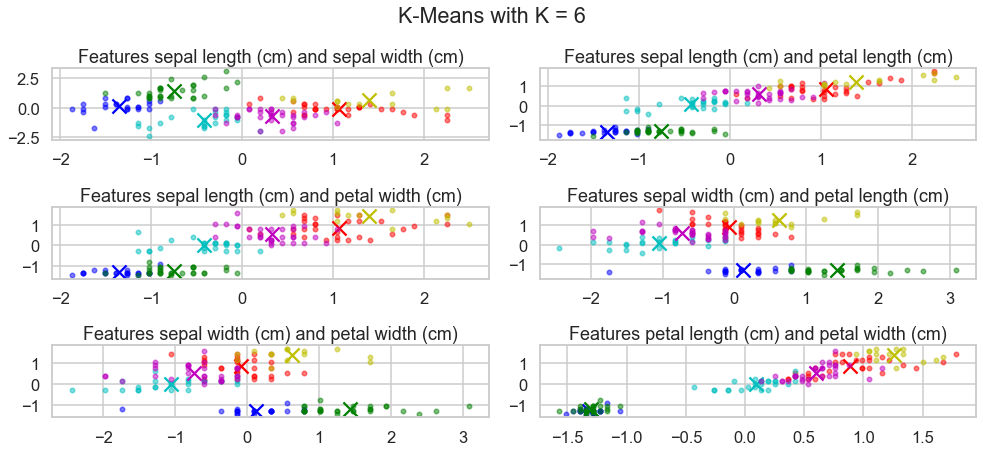

...

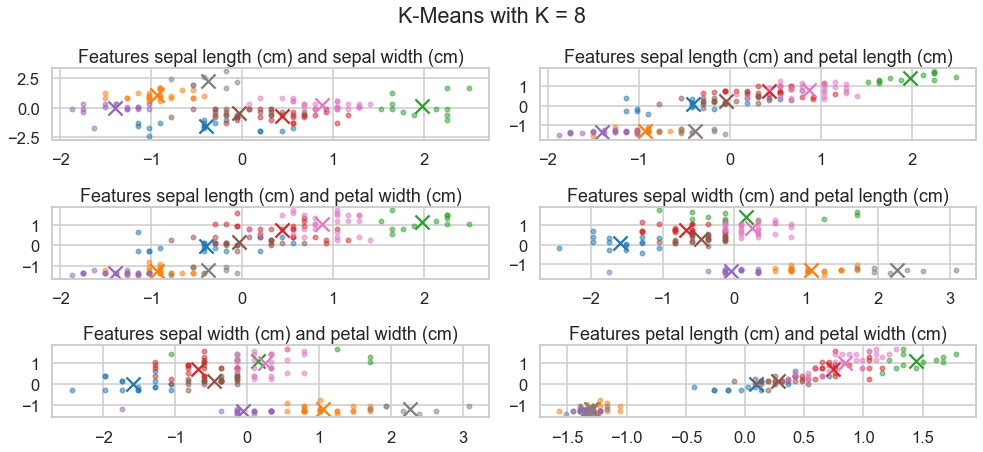

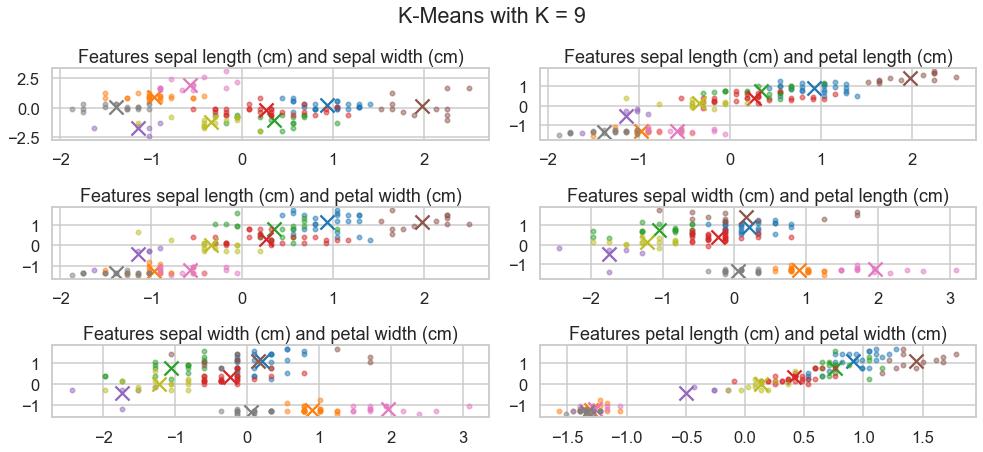

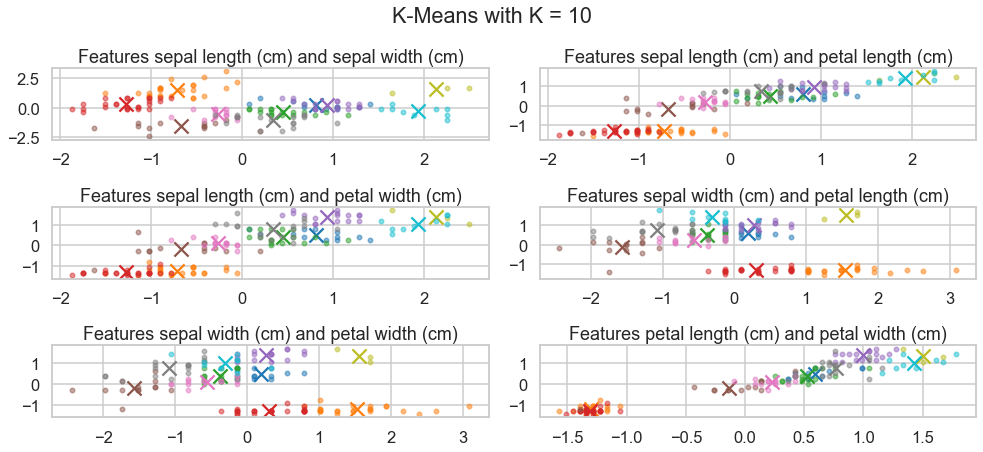

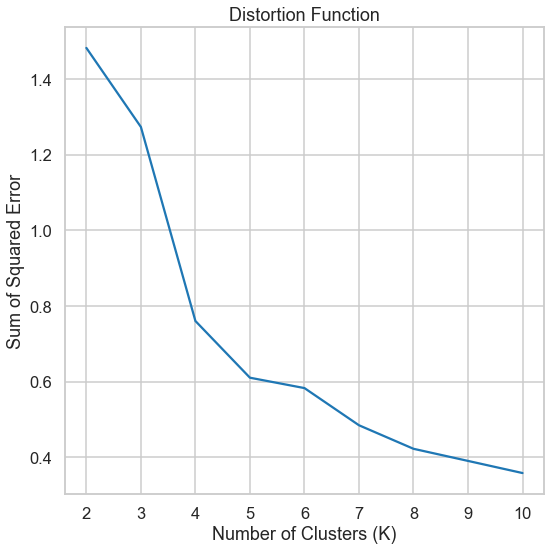

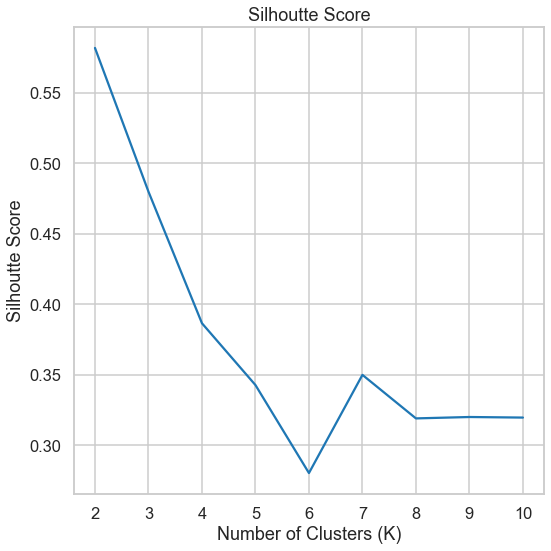

Silhouette Score = 0.5817500491982808 @ K = 2


In [27]:
best_silhouettes = dict()
start_K = 2
stop_K = 11
metrics = []
silhouette = []
for num_clusters in range(start_K,stop_K):
    fig = plt.figure(figsize=(14,12))
    Final_Cluster_Distance = KMeans(n_clusters=num_clusters).fit(X_norm)
    metrics.append(Final_Cluster_Distance.inertia_/len(X_norm))
    silhouette.append(silhouette_score(X_norm, Final_Cluster_Distance.labels_))
    display_cluster(X_norm, km=Final_Cluster_Distance, num_clusters=num_clusters, mode="kmeans", labels=iris_data.feature_names)
    fig.suptitle(f"K-Means with K = {num_clusters}")
    fig.tight_layout()

    
max_pos = np.argmax(silhouette)
params_dict = dict()
params_dict["K"] = max_pos + start_K
params_dict["score"] = silhouette[max_pos]
best_silhouettes.update({"kmeans":params_dict})

plt.figure()
plt.plot(np.arange(start_K,stop_K), metrics)
plt.title("Distortion Function")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Sum of Squared Error")
plt.tight_layout()
plt.show()

plt.figure()
plt.plot(np.arange(start_K,stop_K), silhouette)
plt.title("Silhoutte Score")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Silhoutte Score")
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {silhouette[max_pos]} @ K = {max_pos+start_K}")

In [28]:
Final_Cluster_Distance = KMeans(n_clusters=3, random_state=72).fit(X_norm)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of K-Means Clustering = {acc:.2f}%")

Accuracy of K-Means Clustering = 85.33%


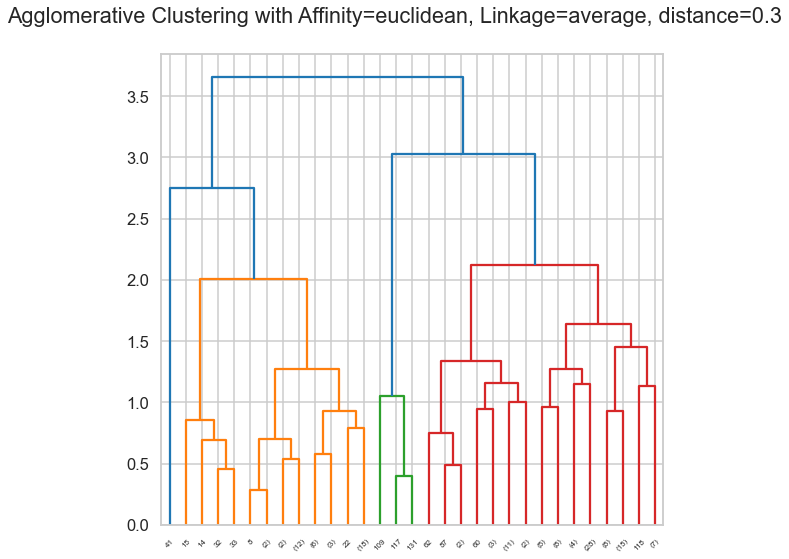

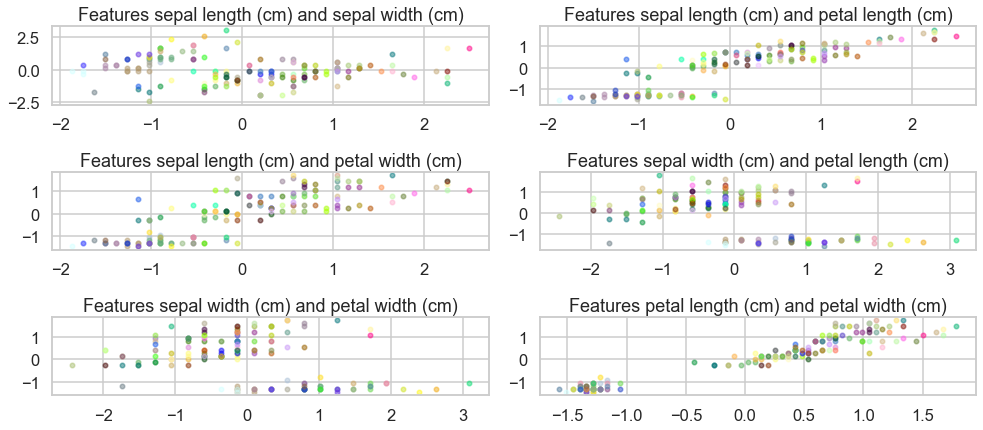

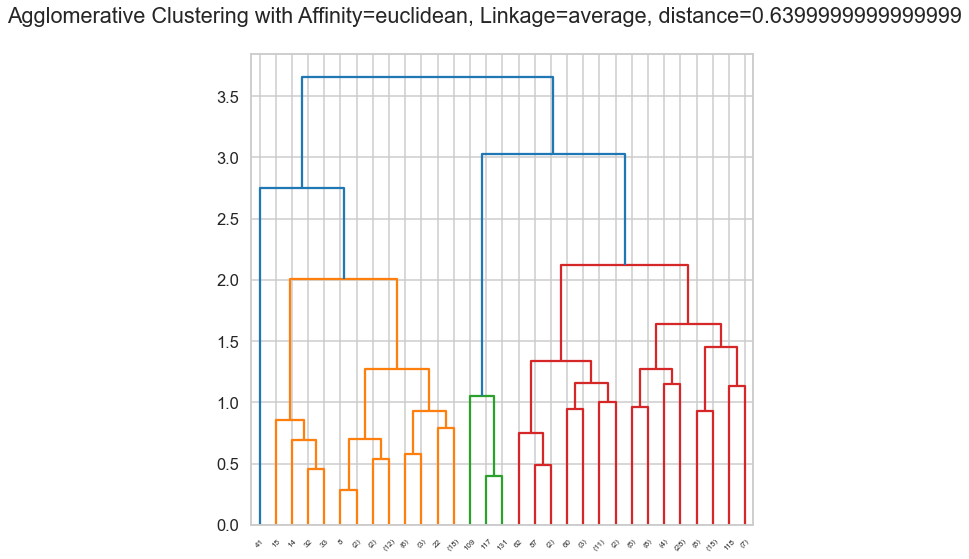

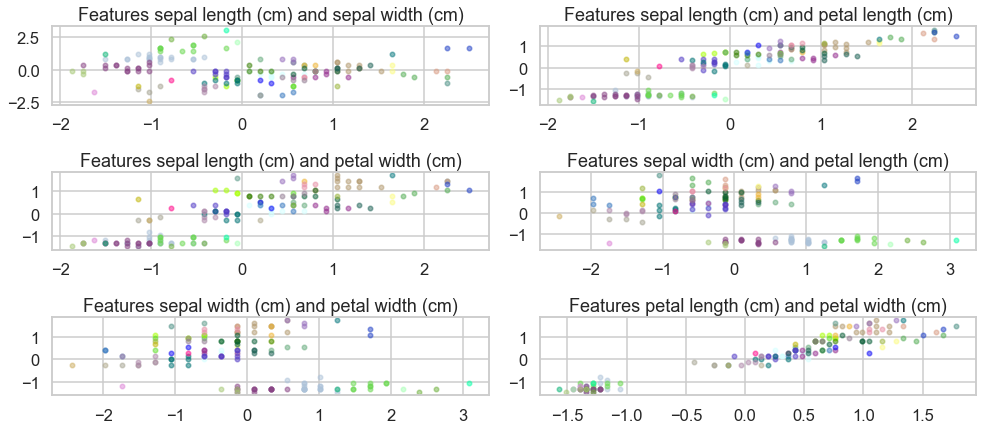

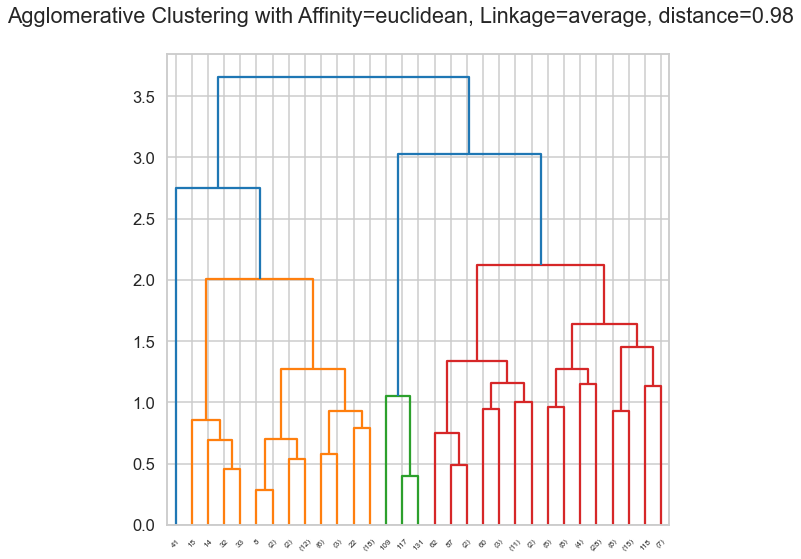

...

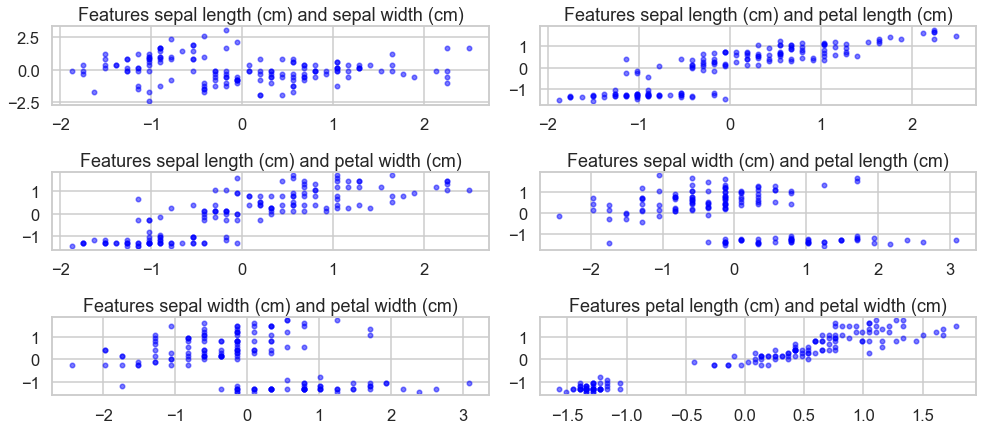

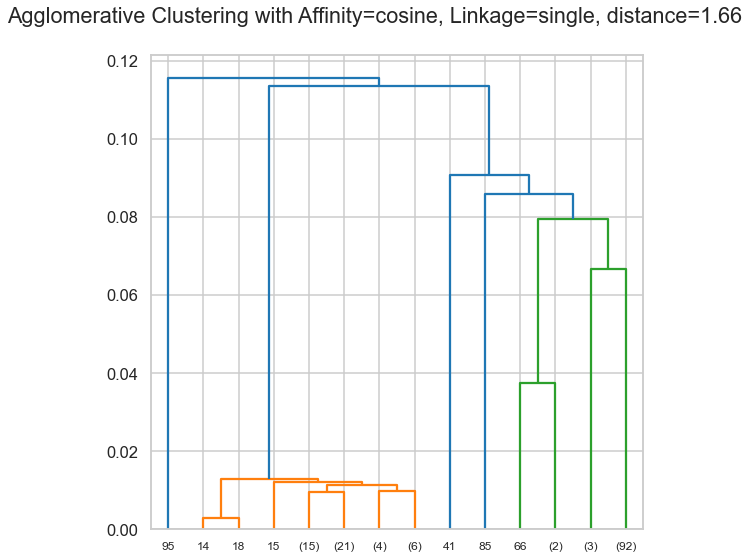

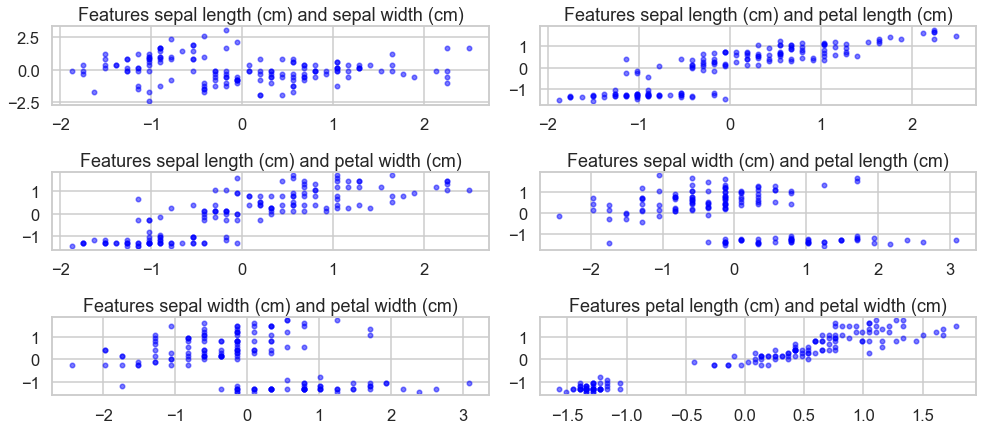

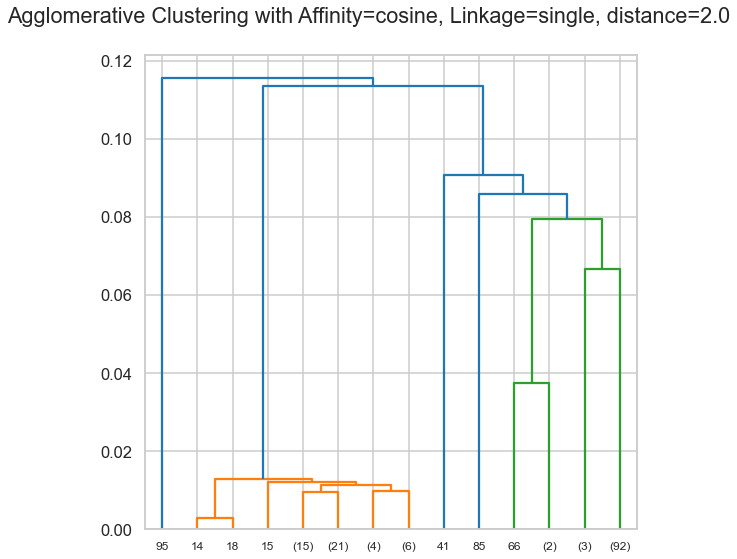

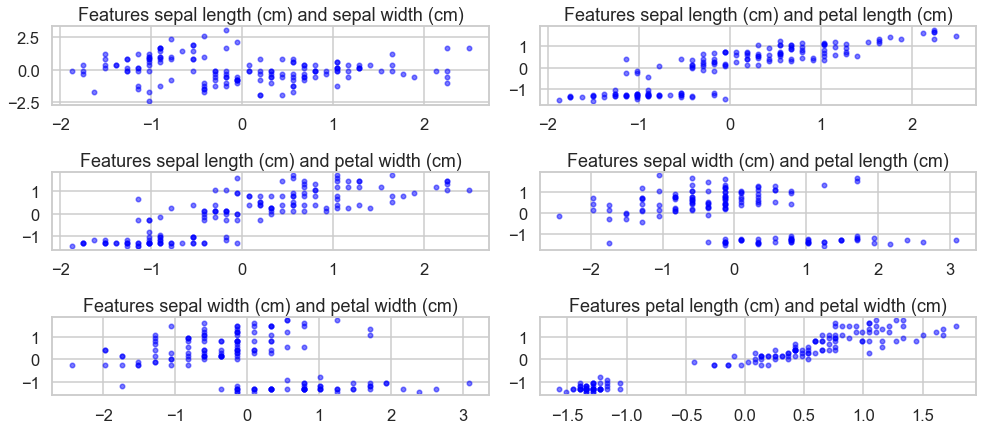

Silhouette Score = 0.5817500491982808 @ Affinity=manhattan, Linkage=single, distance_threshold=2.0


In [29]:
params_dict = dict()
distances = np.linspace(0.3,2,6)
for affinity in ["euclidean", "manhattan", "cosine"]:
    for linkage in ["average","single"]:
        for distance_threshold in distances:
            Final_Cluster_Distance = AgglomerativeClustering(n_clusters=None, metric=affinity, linkage=linkage, distance_threshold=distance_threshold).fit(X_norm)
            if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X_norm, Final_Cluster_Distance.labels_)
                params_dict[(affinity, linkage, distance_threshold)] = silhouette
            plt.suptitle(f"Agglomerative Clustering with Affinity={affinity}, Linkage={linkage}, distance={distance_threshold}")
            plot_dendrogram(Final_Cluster_Distance, truncate_mode="level",p=5)
            plt.tight_layout()
            plt.figure(figsize=(14,12))
            display_cluster(X_norm, km=Final_Cluster_Distance,mode="agglo", labels=iris_data.feature_names)
            plt.tight_layout()
            plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"metric":params[0], "linkage":params[1], "distance_threshold":params[2], "score":score}
best_silhouettes.update({"agglomerative":params_dict})

print(f"Silhouette Score = {score} @ Affinity={params[0]}, Linkage={params[1]}, distance_threshold={params[2]}")

In [30]:
Final_Cluster_Distance = AgglomerativeClustering(n_clusters=3, metric="cosine", linkage="average").fit(X_norm)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target)
Final_Cluster_Distance.labels_ = (1 - Final_Cluster_Distance.labels_)
Final_Cluster_Distance.labels_[Final_Cluster_Distance.labels_==-1] = 2
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Agglomerative Clustering: {acc:.2f}%")

Accuracy of Agglomerative Clustering: 82.00%


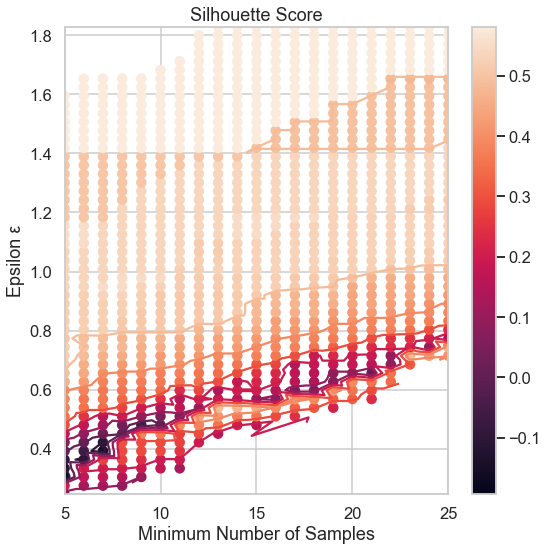

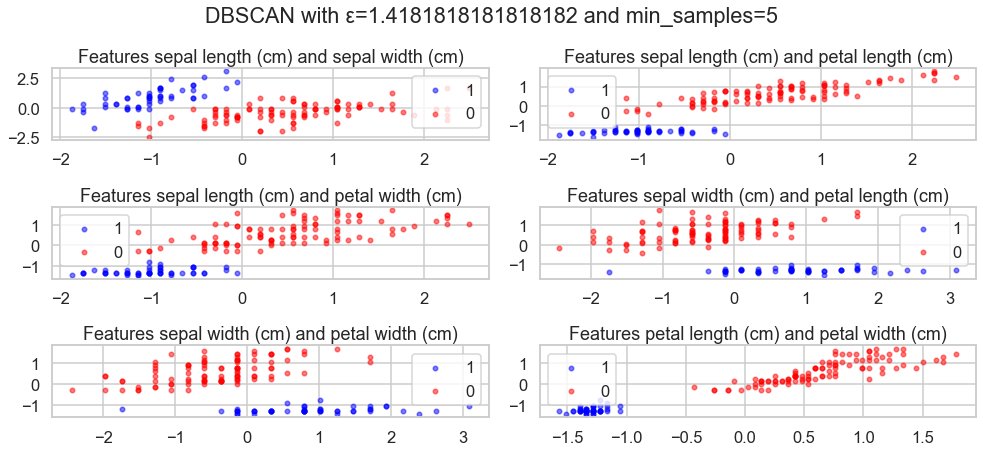

Silhouette Score = 0.5817500491982808 @ ε=1.4181818181818182, min_samples=5.0


In [31]:
params_dict = dict()
epsilons = np.linspace(0.1,3,100)
min_samples_list = np.arange(5,25+1)
for eps in epsilons:
    for min_samples in min_samples_list:
        Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X_norm)
        if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X_norm, Final_Cluster_Distance.labels_)
                params_dict[(eps, min_samples)] = silhouette
        
dict_keys = np.array(list(params_dict.keys()))
dict_vals = np.array(list(params_dict.values()))
eps_vals = dict_keys[:,0]
num_samples_vals = dict_keys[:,1].astype(int)
Z = dict_vals[:]
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"eps":params[0], "min_samples":int(params[1]), "score":score}
best_silhouettes.update({"dbscan":params_dict})

plt.figure()
plt.tricontour(num_samples_vals,eps_vals,Z)
plt.scatter(num_samples_vals, eps_vals, c=Z)
plt.xlabel("Minimum Number of Samples")
plt.ylabel("Epsilon \u03B5")
plt.title("Silhouette Score")
plt.colorbar()
plt.tight_layout()
plt.show()

eps = params[0]
min_samples = int(params[1])
Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X_norm)
plt.figure(figsize=(14,12))
plt.suptitle(f"DBSCAN with \u03B5={eps} and min_samples={min_samples}")
display_cluster(X_norm, km=Final_Cluster_Distance,mode="dbscan", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {score} @ \u03B5={params[0]}, min_samples={params[1]}")

In [32]:
params_dict = dict()
num_clusters = np.arange(2,11)
covariances = ["full", "tied", "diag", "spherical"]
for k in num_clusters:
    for covariance_type_index in range(len(covariances)):
        covariance_type = covariances[covariance_type_index]
        Final_Cluster_Distance = GaussianMixture(n_components=k, covariance_type=covariance_type).fit(X_norm)
        labels = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
        silhouette = silhouette_score(X_norm, labels)
        params_dict[(k, covariance_type)] = silhouette

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"n_components":params[0], "covariance_type":params[1], "score":score}
best_silhouettes.update({"gmm":params_dict})

print(f"Silhouette Score = {score} @ n_components={params[0]}, covariance_type={params[1]}")

Silhouette Score = 0.5817500491982808 @ n_components=2, covariance_type=full


Accuracy of Gaussian Mixing Clustering (full): 96.67%


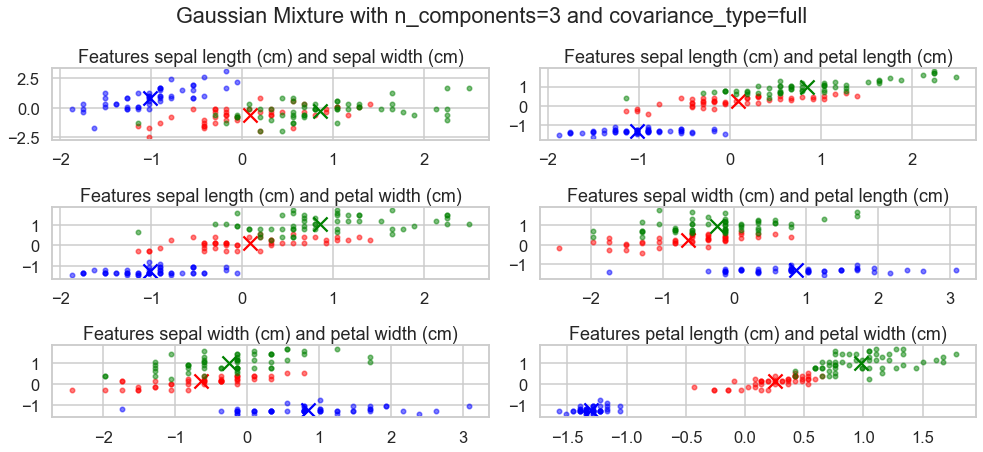

In [33]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="full", random_state=72).fit(X_norm)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (full): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=full")
display_cluster(X_norm,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (full): 96.67%


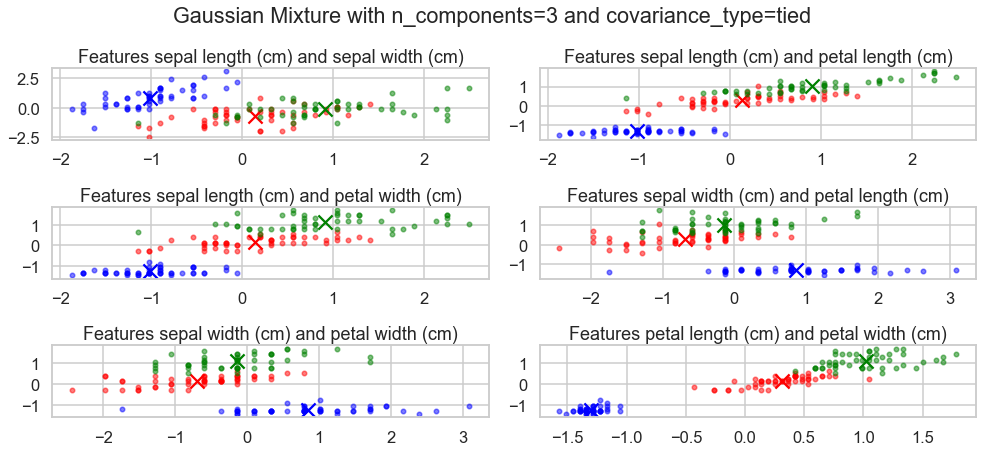

In [34]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="tied", random_state=72).fit(X_norm)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (full): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=tied")
display_cluster(X_norm,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (full): 93.33%


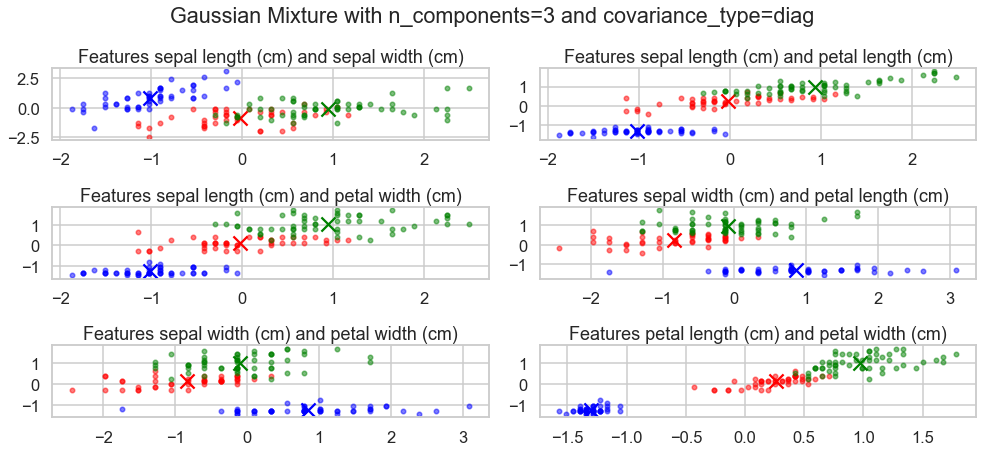

In [35]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="diag", random_state=72).fit(X_norm)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (full): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=diag")
display_cluster(X_norm,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

Accuracy of Gaussian Mixing Clustering (full): 84.00%


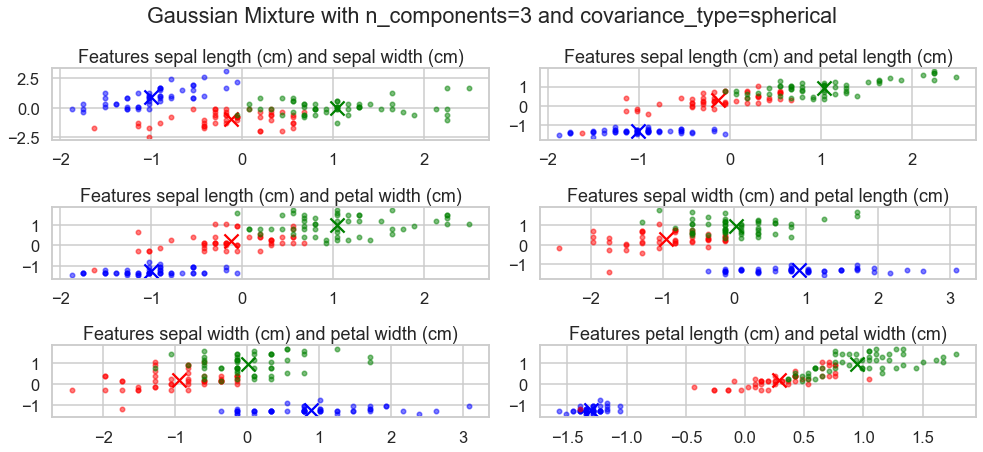

In [36]:
Final_Cluster_Distance = GaussianMixture(n_components = 3, covariance_type="spherical", random_state=72).fit(X_norm)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
acc = np.mean(Final_Cluster_Distance.labels_ == iris_data.target) * 100
print(f"Accuracy of Gaussian Mixing Clustering (full): {acc:.2f}%")
plt.figure(figsize=(14,12))
plt.suptitle(f"Gaussian Mixture with n_components=3 and covariance_type=spherical")
display_cluster(X_norm,km=Final_Cluster_Distance,num_clusters=3,mode="gmm", labels=iris_data.feature_names)
plt.tight_layout()
plt.show()

In [37]:
best_silhouettes

{'kmeans': {'K': 2, 'score': 0.5817500491982808},
 'agglomerative': {'metric': 'manhattan',
  'linkage': 'single',
  'distance_threshold': 2.0,
  'score': 0.5817500491982808},
 'dbscan': {'eps': 1.4181818181818182,
  'min_samples': 5,
  'score': 0.5817500491982808},
 'gmm': {'n_components': 2,
  'covariance_type': 'full',
  'score': 0.5817500491982808}}

## Customer dataset
Repeat all the above on the customer data set 

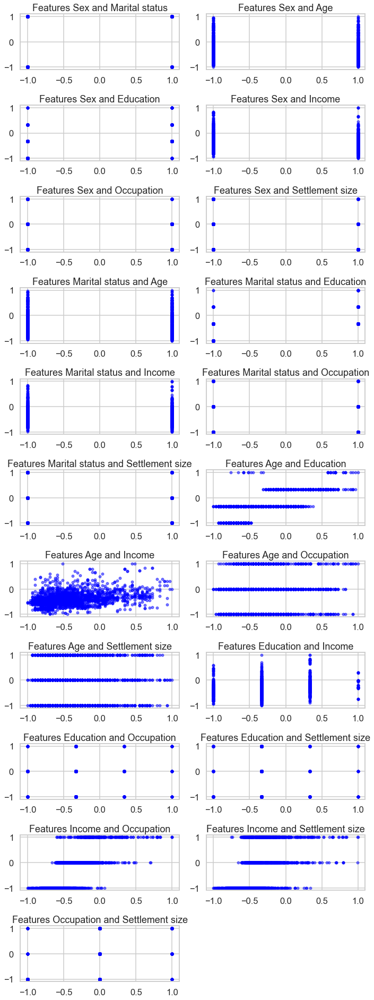

In [38]:
from sklearn.preprocessing import MinMaxScaler
X = pd.read_csv("C:\\Users\\Karim\Downloads\\College\\Semester 10\\NETW1013 - Machine Learning\\Week 2\\Assignment 1\\Customer data.csv")
X.drop(labels=["ID"], axis=1, inplace=True)
labels = list(X.keys())
scaler = MinMaxScaler(feature_range=(-1,1))
X_norm = scaler.fit_transform(X.to_numpy(dtype=np.float64))
plt.figure(figsize=(10,50))
display_cluster(X_norm, labels=labels)

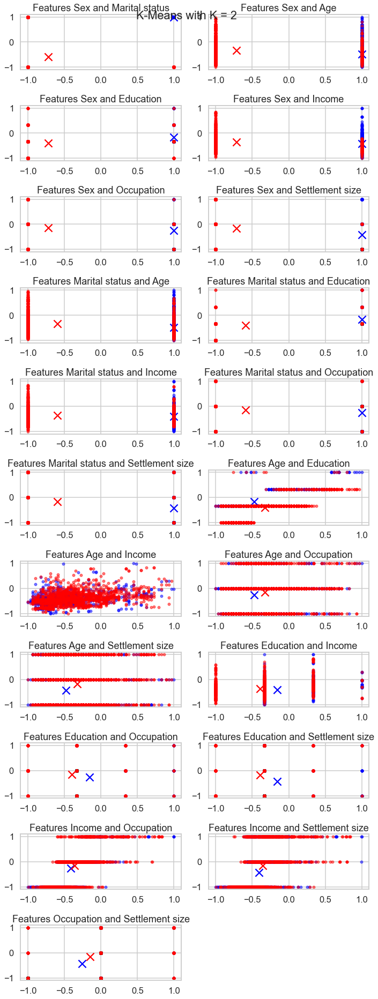

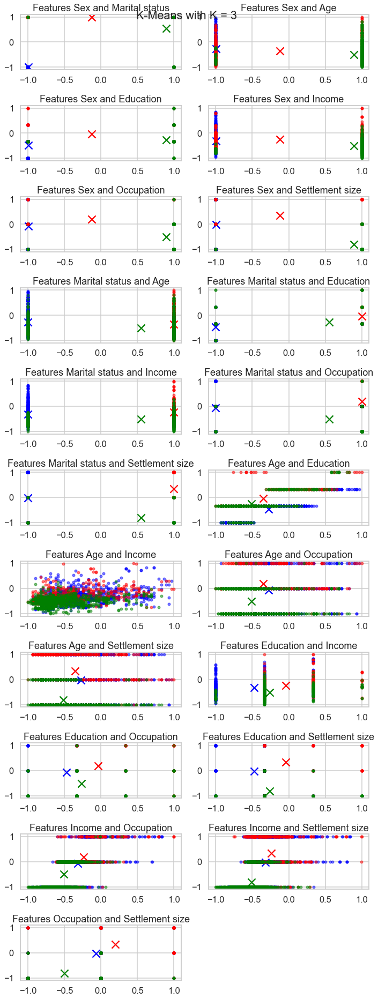

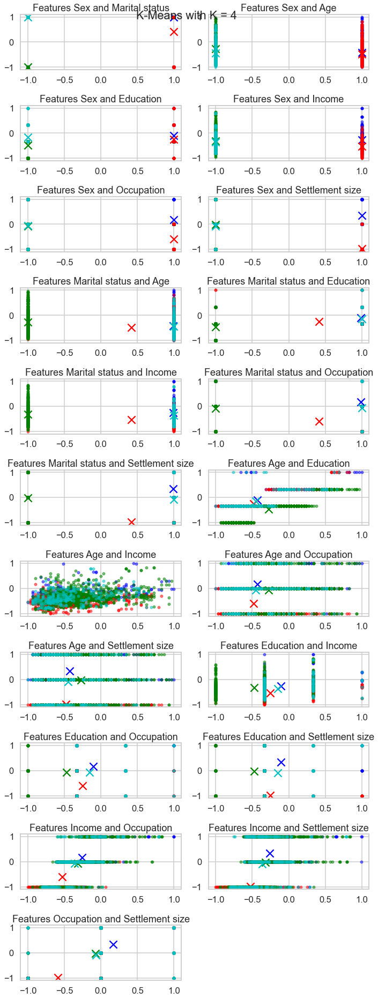

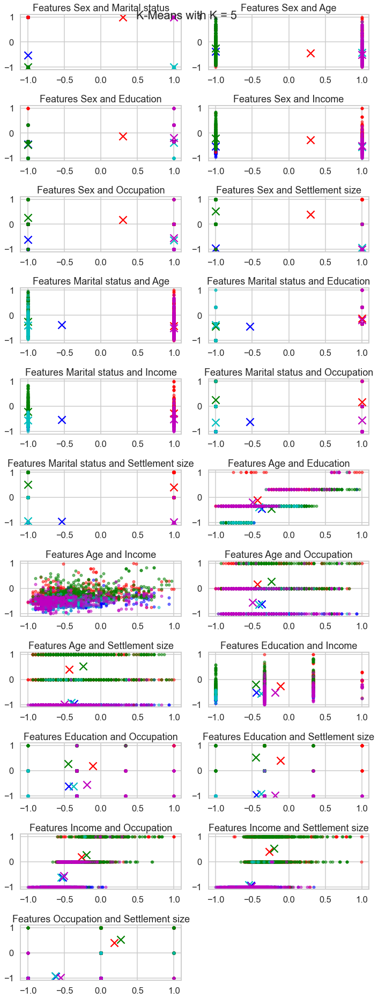

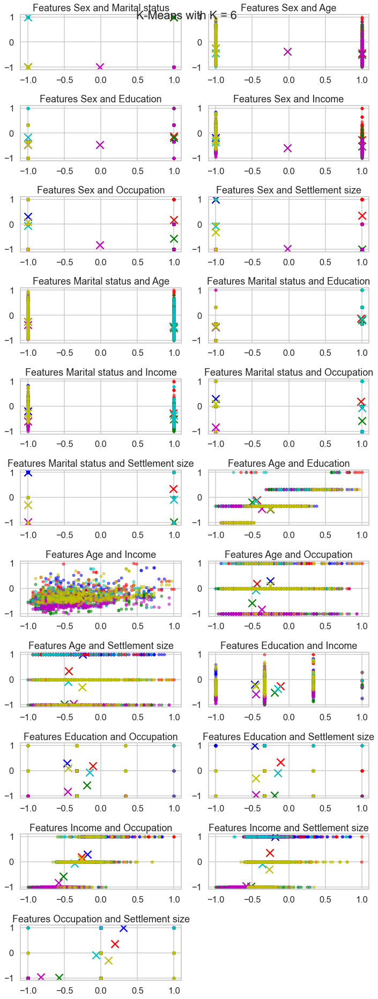

...

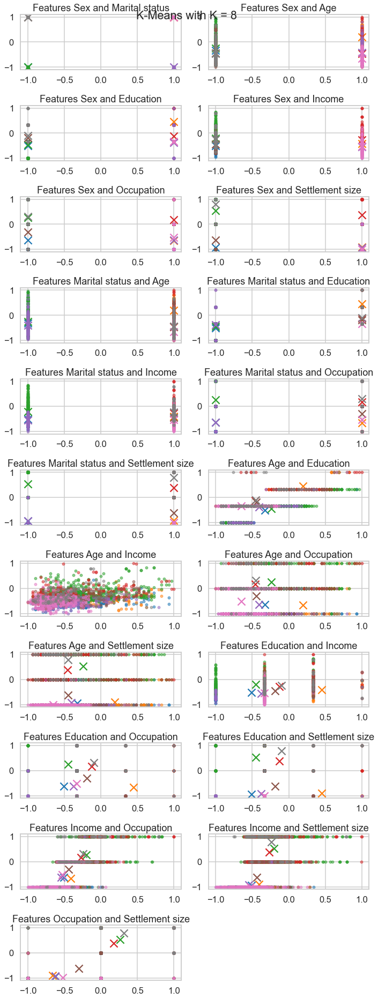

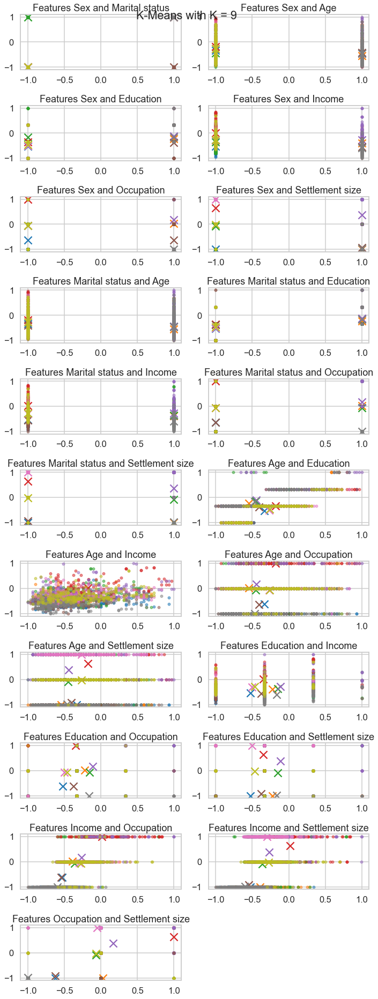

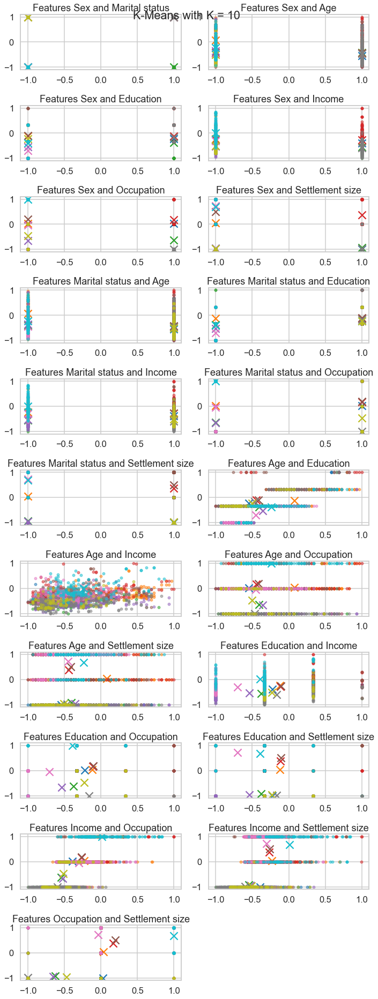

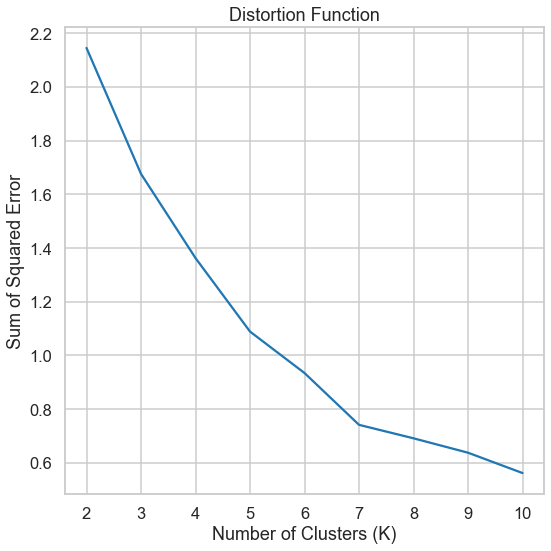

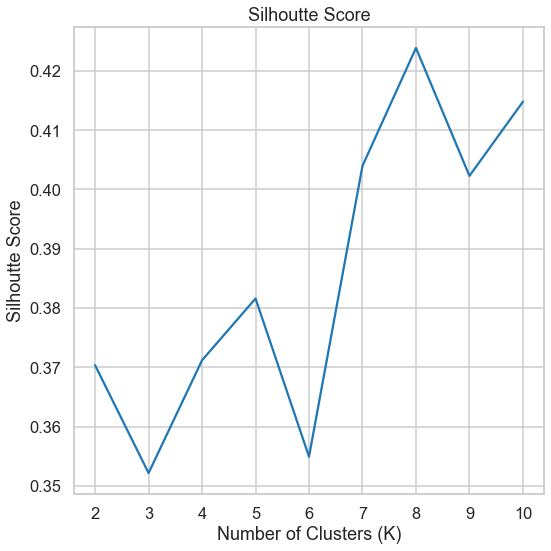

Silhouette Score = 0.4238446648931027 @ K = 8


In [39]:
best_silhouettes = dict()
start_K = 2
stop_K = 11
metrics = []
silhouette = []
for num_clusters in range(start_K,stop_K):
    fig = plt.figure(figsize=(10,50))
    Final_Cluster_Distance = KMeans(n_clusters=num_clusters).fit(X_norm)
    metrics.append(Final_Cluster_Distance.inertia_/len(X_norm))
    silhouette.append(silhouette_score(X_norm, Final_Cluster_Distance.labels_))
    display_cluster(X_norm, km=Final_Cluster_Distance, num_clusters=num_clusters, mode="kmeans", labels=labels)
    fig.suptitle(f"K-Means with K = {num_clusters}")
    fig.tight_layout()

    
max_pos = np.argmax(silhouette)
params_dict = dict()
params_dict["K"] = max_pos + start_K
params_dict["score"] = silhouette[max_pos]
best_silhouettes.update({"kmeans":params_dict})

plt.figure()
plt.plot(np.arange(start_K,stop_K), metrics)
plt.title("Distortion Function")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Sum of Squared Error")
plt.tight_layout()
plt.show()

plt.figure()
plt.plot(np.arange(start_K,stop_K), silhouette)
plt.title("Silhoutte Score")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Silhoutte Score")
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {silhouette[max_pos]} @ K = {max_pos+start_K}")

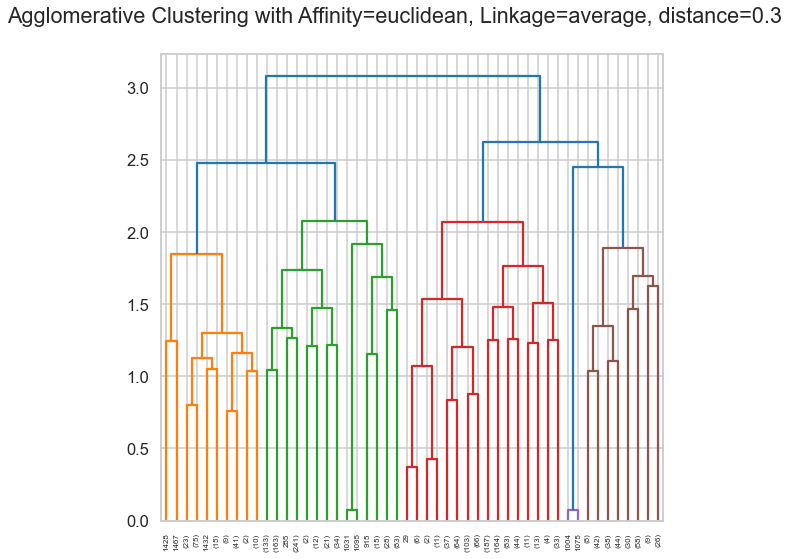

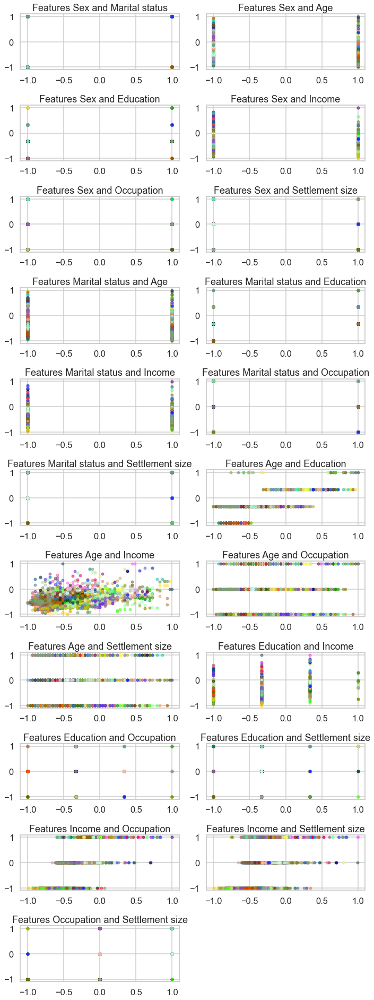

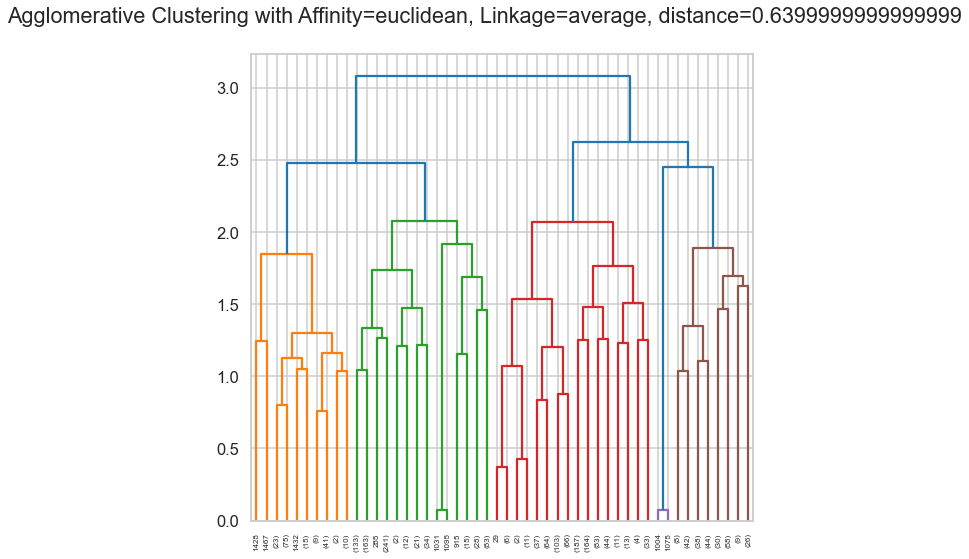

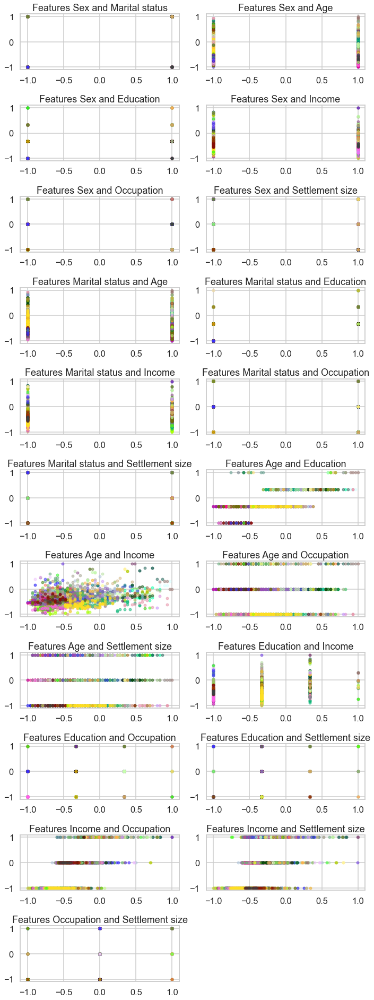

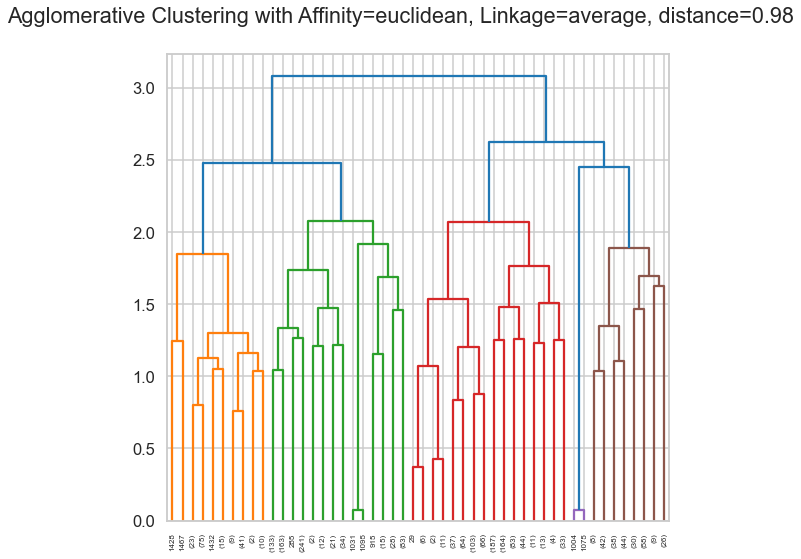

...

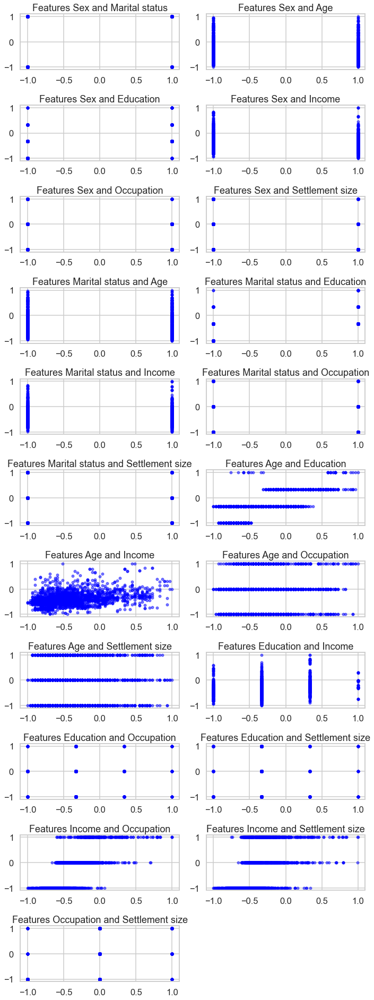

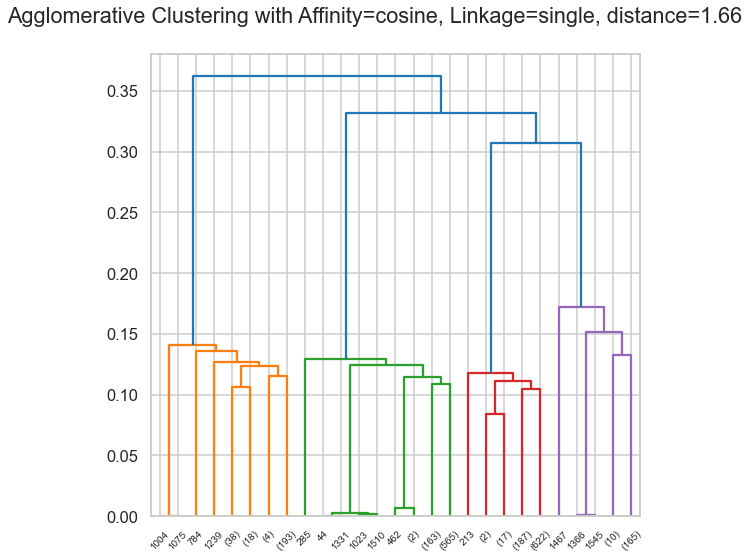

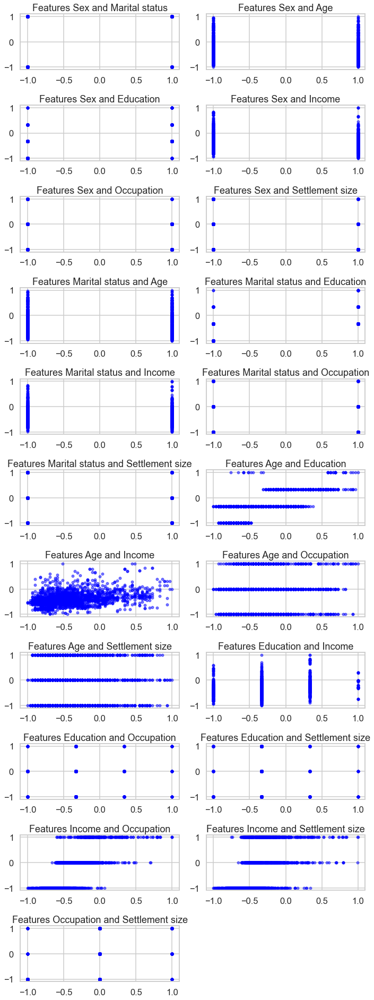

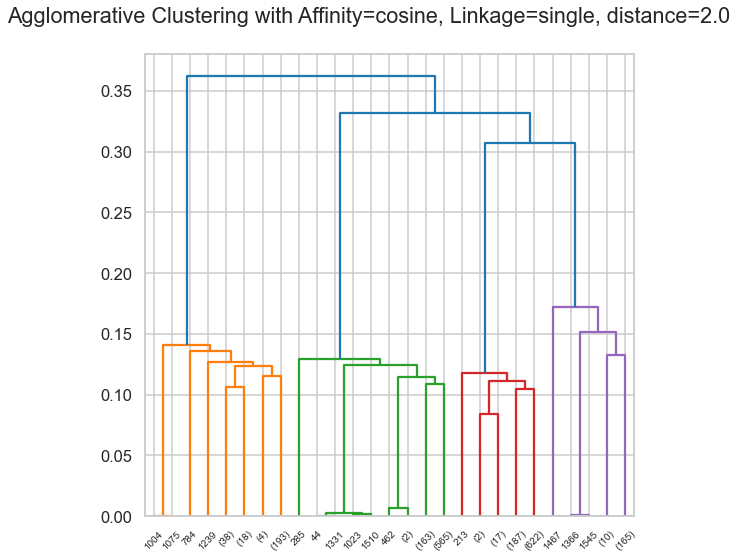

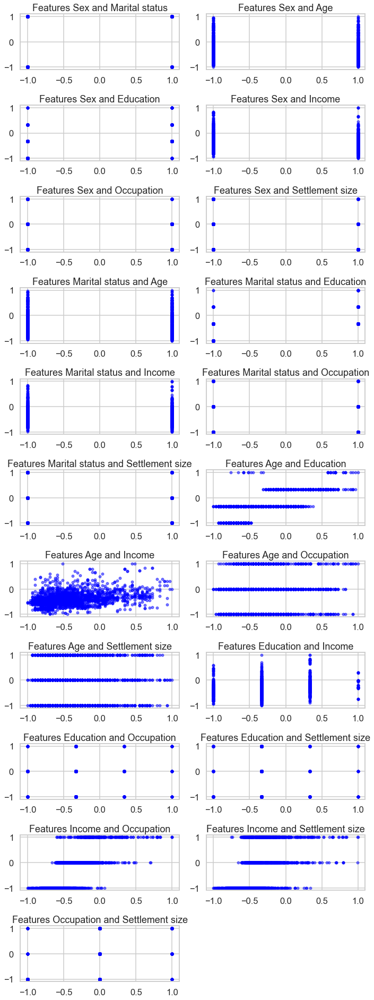

Silhouette Score = 0.6522300904573638 @ Affinity=manhattan, Linkage=average, distance_threshold=0.98


In [40]:
params_dict = dict()
distances = np.linspace(0.3,2,6)
for affinity in ["euclidean", "manhattan", "cosine"]:
    for linkage in ["average","single"]:
        for distance_threshold in distances:
            Final_Cluster_Distance = AgglomerativeClustering(n_clusters=None, metric=affinity, linkage=linkage, distance_threshold=distance_threshold).fit(X_norm)
            if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X_norm, Final_Cluster_Distance.labels_)
                params_dict[(affinity, linkage, distance_threshold)] = silhouette
            plt.suptitle(f"Agglomerative Clustering with Affinity={affinity}, Linkage={linkage}, distance={distance_threshold}")
            plot_dendrogram(Final_Cluster_Distance, truncate_mode="level",p=5)
            plt.tight_layout()
            plt.figure(figsize=(10,50))
            display_cluster(X_norm, km=Final_Cluster_Distance,mode="agglo", labels=labels)
            plt.tight_layout()
            plt.show()

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"metric":params[0], "linkage":params[1], "distance_threshold":params[2], "score":score}
best_silhouettes.update({"agglomerative":params_dict})

print(f"Silhouette Score = {score} @ Affinity={params[0]}, Linkage={params[1]}, distance_threshold={params[2]}")

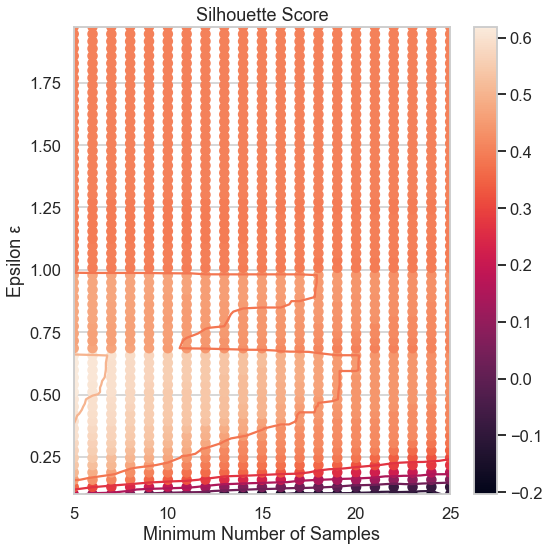

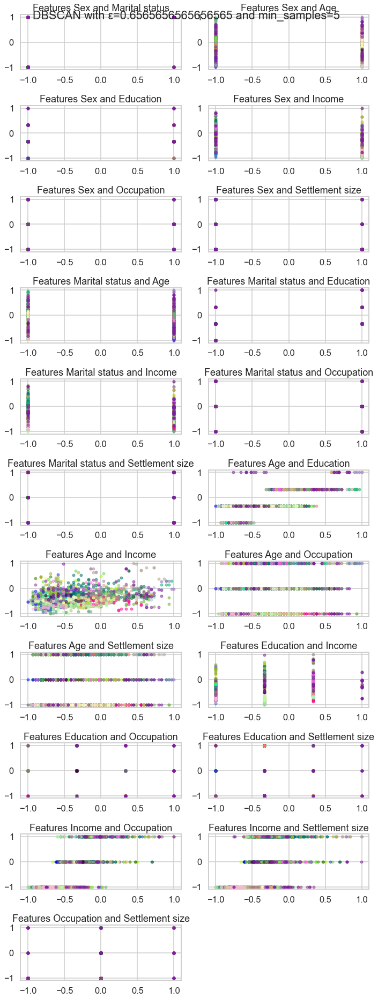

Silhouette Score = 0.6192050218196841 @ ε=0.6565656565656565, min_samples=5.0


In [41]:
params_dict = dict()
epsilons = np.linspace(0.1,3,100)
min_samples_list = np.arange(5,25+1)
for eps in epsilons:
    for min_samples in min_samples_list:
        Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X_norm)
        if len(np.unique(Final_Cluster_Distance.labels_)) >= 2:
                silhouette = silhouette_score(X_norm, Final_Cluster_Distance.labels_)
                params_dict[(eps, min_samples)] = silhouette
        
dict_keys = np.array(list(params_dict.keys()))
dict_vals = np.array(list(params_dict.values()))
eps_vals = dict_keys[:,0]
num_samples_vals = dict_keys[:,1].astype(int)
Z = dict_vals[:]
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"eps":params[0], "min_samples":int(params[1]), "score":score}
best_silhouettes.update({"dbscan":params_dict})

plt.figure()
plt.tricontour(num_samples_vals,eps_vals,Z)
plt.scatter(num_samples_vals, eps_vals, c=Z)
plt.xlabel("Minimum Number of Samples")
plt.ylabel("Epsilon \u03B5")
plt.title("Silhouette Score")
plt.colorbar()
plt.tight_layout()
plt.show()

eps = params[0]
min_samples = int(params[1])
Final_Cluster_Distance = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean", n_jobs=-1).fit(X_norm)
fig = plt.figure(figsize=(10,50))
plt.suptitle(f"DBSCAN with \u03B5={eps} and min_samples={min_samples}")
display_cluster(X_norm, km=Final_Cluster_Distance,mode="dbscan", labels=labels, legend=False)
plt.tight_layout()
plt.show()

print(f"Silhouette Score = {score} @ \u03B5={params[0]}, min_samples={params[1]}")

In [43]:
params_dict = dict()
num_clusters = np.arange(2,11)
covariances = ["full", "tied", "diag", "spherical"]
for k in num_clusters:
    for covariance_type_index in range(len(covariances)):
        covariance_type = covariances[covariance_type_index]
        Final_Cluster_Distance = GaussianMixture(n_components=k, covariance_type=covariance_type).fit(X_norm)
        gmm_labels = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
        silhouette = silhouette_score(X_norm, gmm_labels)
        params_dict[(k, covariance_type)] = silhouette

dict_keys = list(params_dict.keys())
dict_vals = list(params_dict.values())
max_pos = np.argmax(dict_vals)
params = dict_keys[max_pos]
score = dict_vals[max_pos]
params_dict = {"n_components":params[0], "covariance_type":params[1], "score":score}
best_silhouettes.update({"gmm":params_dict})

print(f"Silhouette Score = {score} @ n_components={params[0]}, covariance_type={params[1]}")

Silhouette Score = 0.4367213185481697 @ n_components=6, covariance_type=tied


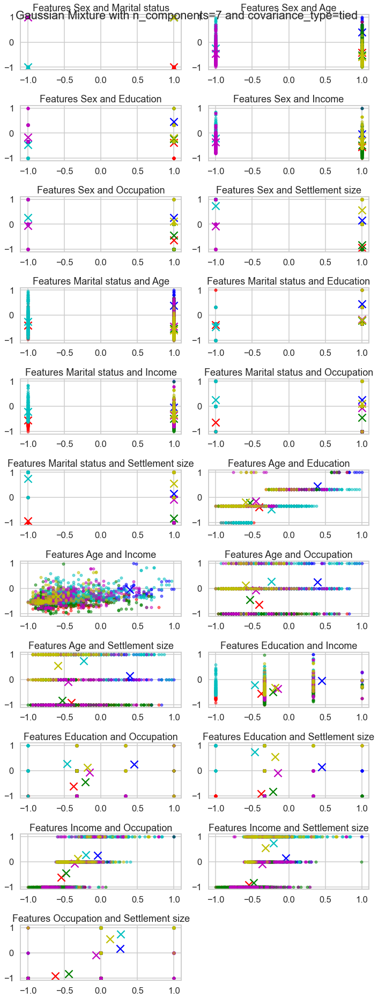

In [44]:
Final_Cluster_Distance = GaussianMixture(n_components = 7, covariance_type="tied").fit(X_norm)
Final_Cluster_Distance.labels_ = np.argmax(Final_Cluster_Distance.predict_proba(X_norm), axis=1)
fig = plt.figure(figsize=(10,50))
plt.suptitle(f"Gaussian Mixture with n_components=7 and covariance_type=tied")
display_cluster(X_norm,km=Final_Cluster_Distance,num_clusters=6,mode="gmm", labels=labels)
plt.tight_layout()
plt.show()

In [45]:
best_silhouettes

{'kmeans': {'K': 8, 'score': 0.4238446648931027},
 'agglomerative': {'metric': 'manhattan',
  'linkage': 'average',
  'distance_threshold': 0.98,
  'score': 0.6522300904573638},
 'dbscan': {'eps': 0.6565656565656565,
  'min_samples': 5,
  'score': 0.6192050218196841},
 'gmm': {'n_components': 6,
  'covariance_type': 'tied',
  'score': 0.4367213185481697}}